# **installments** 

In [ ]:
!pip install turicreate

     |████████████████████████████████| 92.0 MB 5.9 kB/s 
     |████████████████████████████████| 322 kB 50.3 MB/s 
     |████████████████████████████████| 86.4 MB 18 kB/s 
     |████████████████████████████████| 3.5 MB 32.8 MB/s 
     |████████████████████████████████| 3.6 MB 43.5 MB/s 
     |████████████████████████████████| 18.3 MB 73 kB/s 
     |████████████████████████████████| 50 kB 6.7 MB/s 
     |████████████████████████████████| 3.8 MB 30.9 MB/s 
     |████████████████████████████████| 2.9 MB 33.4 MB/s 
     |████████████████████████████████| 449 kB 60.2 MB/s 
     |████████████████████████████████| 20.1 MB 1.3 MB/s 
  Created wheel for prettytable: filename=prettytable-0.7.2-py3-none-any.whl size=13714 sha256=2d12e54ed758a6ee6bde696e4685cf583b79451c0ac4314852541edaf9213bee
  Stored in directory: /root/.cache/pip/wheels/b2/7f/f6/f180315b584f00445045ff1699b550fa895d09471337ce21c6
  Created wheel for resampy: filename=resampy-0.2.1-py3-none-any.whl size=320860 sha256=d276fe0947e

In [ ]:
# see more details in the course first lecture
!mkdir /root/.kaggle/
import json
import os

# Installing the Kaggle package
!pip install kaggle 

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"grinshpanyonatan","key":"??"}

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle/’: File exists


In [ ]:
!mkdir ./datasets
!mkdir ./datasets/UFO

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d rishidamarla/ufo-sightings-approx-100000 -p ./datasets/UFO

!unzip ./datasets/UFO/*.zip  -d ./datasets/UFO

 87% 33.0M/37.8M [00:01<00:00, 20.1MB/s]
100% 37.8M/37.8M [00:01<00:00, 34.0MB/s]
Archive:  ./datasets/UFO/ufo-sightings-approx-100000.zip
  inflating: ./datasets/UFO/nuforc_reports.csv  


In [ ]:
import turicreate as tc
import turicreate.aggregate as agg

sf_UFO = tc.SFrame.read_csv('/content/datasets/UFO/nuforc_reports.csv')
sf_UFO

Finished parsing file /content/datasets/UFO/nuforc_reports.csv

Parsing completed. Parsed 100 lines in 1.3319 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,str,str,str,str,str,str,str,str,float,float]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 34525 lines. Lines per second: 22873.6

Finished parsing file /content/datasets/UFO/nuforc_reports.csv

Parsing completed. Parsed 88125 lines in 2.02072 secs.

summary,city,state,date_time,shape,duration
My wife was drivingsoutheast on a fairly ...,Chester,VA,2019-12-12T18:43:00,light,5 seconds
I think that I may caughta UFO on the NBC Nightly ...,Rocky Hill,CT,2019-03-22T18:30:00,circle,3-5 seconds
I woke up late in theafternoon 3:30-4pm. I ...,,,,,
I was driving towards theintersection of ...,Ottawa,ON,2019-04-17T02:00:00,teardrop,10 seconds
"In Peoria Arizona, I sawa cigar shaped craft ...",Peoria,NY,2009-03-15T18:00:00,cigar,2 minutes
"The object has flashinglights that are green, ...",Kirbyville,TX,2019-04-02T20:25:00,disk,15 minutes
Description is the sameas Washington DC even ...,Tucson,AZ,2019-05-01T11:00:00,unknown,5 minutes
Apr. 10th we witnessed avery bright silvery r ...,Gold Canyon,AZ,2019-04-10T17:00:00,circle,10 minutes
Ufos report in IrvingTexas at 2200 hrs. On or ...,Dallas,TX,1973-07-14T22:00:00,oval,6 minutes
Group of lights formationsweeping thru a night ...,Caloocan City(Philippines) ...,,2019-06-06T19:00:00,other,19:00 to 19:30


In [ ]:
#lets add column 'year' to our sframe 
def get_year(date):
  if date != '':
    date = date.split('-')
    return date[0]

sf_UFO['year'] = sf_UFO['date_time'].apply(lambda date: get_year(date))

In [ ]:
#drop all NA
sf_UFO = sf_UFO.dropna()

In [ ]:
#add location
sf_UFO['location'] = sf_UFO.apply(lambda r: str(r['city_latitude'])+ ',' + str(r['city_longitude']))

In [ ]:
from matplotlib import pyplot as plt
import plotly.express as px
import turicreate.aggregate as agg
g = sf_UFO.groupby('year', {'number of UFO sights': agg.COUNT()}).sort('year')
g = g.to_dataframe()
fig = px.bar(g, y='year', x='number of UFO sights', color='year',title='year and numbers of UFO sights',orientation='h')
fig.update_layout(
    autosize=False,
    width=750,
    height=1000,)
fig.update_yaxes(nticks=102)

In [ ]:
g = sf_UFO.groupby('state', {'number of UFO sights': agg.COUNT()}).sort('number of UFO sights',ascending=False)
g = g.to_dataframe()
fig = px.bar(g, y='state', x='number of UFO sights', color='state',title='state and numbers of UFO sights',orientation='h')
fig.update_layout(
    autosize=False,
    width=750,
    height=1000,)
fig.update_yaxes(nticks=102)

In [ ]:
#divide each record into it's decade
def get_decade(year):
  year = int(year)
  if year == 1969:
    return str(1969)
  if 1969 < year and year < 1980:
    return '70s, between 1970 and 1980'
  if 1979 < year and year < 1990:
    return '80s,between 1980 and 1990'
  if 1989 < year and year < 2000:
    return '90s, between 1990 and 2000'
  if 1999 < year and year < 2010:
    return '2000s, between 2000 and 2010'
  if 2009 < year and year < 2020:
    return '2010s, between 2010 and 2020'

sf_UFO['decade'] = sf_UFO['year'].apply(lambda year: get_decade(year))

In [ ]:
g = sf_UFO.groupby('decade', {'number of UFO sights': agg.COUNT()}).sort('decade')
g

decade,number of UFO sights
1969,68
"2000s, between 2000 and2010 ...",16140
"2010s, between 2010 and2020 ...",51689
"70s, between 1970 and1980 ...",1033
"80s,between 1980 and 1990",865
"90s, between 1990 and2000 ...",1384


# **question 1 part 1**

show how the text changed over the centuries

In [ ]:
#create a new and smaller sframe because spacy dosent run on all the sframe. i choose 3 states in the us
sf_ufo_cali = sf_UFO[sf_UFO['state'] == 'CA']
sf_ufo_washington = sf_UFO[sf_UFO['state'] == 'WA']
sf_ufo_oregon = sf_UFO[sf_UFO['state'] == 'OR']
sf_ufo_west_coast = sf_ufo_cali.append(sf_ufo_washington).append(sf_ufo_oregon)
len(sf_ufo_west_coast)


13690

In [ ]:
import nltk
import spacy
from tqdm import tqdm
nltk.download('stopwords')
nltk.download('punkt')
!python -m spacy download en_core_web_lg #

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
     |████████████████████████████████| 827.9 MB 1.3 MB/s 
  Created wheel for en-core-web-lg: filename=en_core_web_lg-2.2.5-py3-none-any.whl size=829180943 sha256=720af9cb5850223901b0f9aac83ccf0cc540d321ee134f31305ebe2afdb60e1a
  Stored in directory: /tmp/pip-ephem-wheel-cache-ca4y_45e/wheels/11/95/ba/2c36cc368c0bd339b44a791c2c1881a1fb714b78c29a4cb8f5
Successfully built en-core-web-lg
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_lg')


In [ ]:
import spacy
from tqdm import tqdm
nlp = spacy.load('en_core_web_lg')

#looking for patterns in huge amount of Descriptions
def get_entites_from_text(text):
    entities_dict= {}
    #using spaCy to get entities
    doc = nlp(text)
    for entity in doc.ents:
        label = entity.label_
        if  label not in entities_dict:
            entities_dict[label] = set()
        entities_dict[label].add(entity.text)        

    return entities_dict

In [ ]:
l = []

for i in tqdm(range(len(sf_ufo_west_coast))):
    t = sf_ufo_west_coast[i]['text']
    l.append(get_entites_from_text(t))

sf_ufo_west_coast['entities_dict'] = l
   

In [ ]:
#crate list to hold the different sframes by decade
sf_ufo_west_coast_all_decades = []
sf_ufo_west_coast_69 = sf_ufo_west_coast[sf_ufo_west_coast['year'] == '1969']
sf_ufo_west_coast_70s = sf_ufo_west_coast[sf_ufo_west_coast['decade'] == '70s, between 1970 and 1980']
sf_ufo_west_coast_80s = sf_ufo_west_coast[sf_ufo_west_coast['decade'] == '80s,between 1980 and 1990']
sf_ufo_west_coast_90s = sf_ufo_west_coast[sf_ufo_west_coast['decade'] == '90s, between 1990 and 2000']
sf_ufo_west_coast_2000s = sf_ufo_west_coast[sf_ufo_west_coast['decade'] =='2000s, between 2000 and 2010']
sf_ufo_west_coast_2010s = sf_ufo_west_coast[sf_ufo_west_coast['decade'] =='2010s, between 2010 and 2020']

sf_ufo_west_coast_all_decades.append(sf_ufo_west_coast_69)
sf_ufo_west_coast_all_decades.append(sf_ufo_west_coast_70s)
sf_ufo_west_coast_all_decades.append(sf_ufo_west_coast_80s)
sf_ufo_west_coast_all_decades.append(sf_ufo_west_coast_90s)
sf_ufo_west_coast_all_decades.append(sf_ufo_west_coast_2000s)
sf_ufo_west_coast_all_decades.append(sf_ufo_west_coast_2010s)

In [ ]:
#create different dicts by decade to later hold information for each decade
dicts = []
count_entities_dict_69  = {}
count_entities_dict_70s = {}
count_entities_dict_80s = {}
count_entities_dict_90s = {}
count_entities_dict_2000s = {}
count_entities_dict_2010s = {}

dicts.append(count_entities_dict_69)
dicts.append(count_entities_dict_70s)
dicts.append(count_entities_dict_80s)
dicts.append(count_entities_dict_90s)
dicts.append(count_entities_dict_2000s)
dicts.append(count_entities_dict_2010s)

In [ ]:

def count_entities_dict(dict_,sf): 
  for d in sf['entities_dict']:
      for entity_type, entity_set in d.items():
          if entity_type not in dict_:
              dict_[entity_type] = {}
          for name in entity_set:
              name = name.replace("\n", " ").strip().lower()
              if name not in dict_[entity_type]:
                  dict_[entity_type][name] = 0
              dict_[entity_type][name] += 1

#now we call this function for each decade             
for i in range(6):
  count_entities_dict(dicts[i],sf_ufo_west_coast_all_decades[i])


In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS
%matplotlib inline

def draw_entities_word_cloud(entity_type, min_times,dict_,decade):
    stopwords = set(STOPWORDS) | {"doc", "date","memo", "subject", 'state',
                                 }
    stopwords_parts = {"sent", "subject", "original message", "unclassified" }
    wordcloud = WordCloud(width = 400, height = 400, 
                    background_color ='black', 
                    stopwords = stopwords, 
                    min_font_size = 10)
    def skip_entity(e):
        if e in stopwords:
            return True
        for p in stopwords_parts:
            if p in e:
                return True
        return False

    # using the subject frquencies
    
    d = {k:v for k,v in dict_[entity_type].items() if v > min_times and not skip_entity(k)}
    try:
      wordcloud.generate_from_frequencies(frequencies=d)
      print('displaying value for: ', decade)
    except:
      print('no value for' , decade)
      return
      
      
    plt.figure(figsize = (20, 20), facecolor = None) 
    plt.imshow(wordcloud)


no value for year 1969
displaying value for:  70s
displaying value for:  80s
displaying value for:  90s
displaying value for:  2000s
displaying value for:  2010s


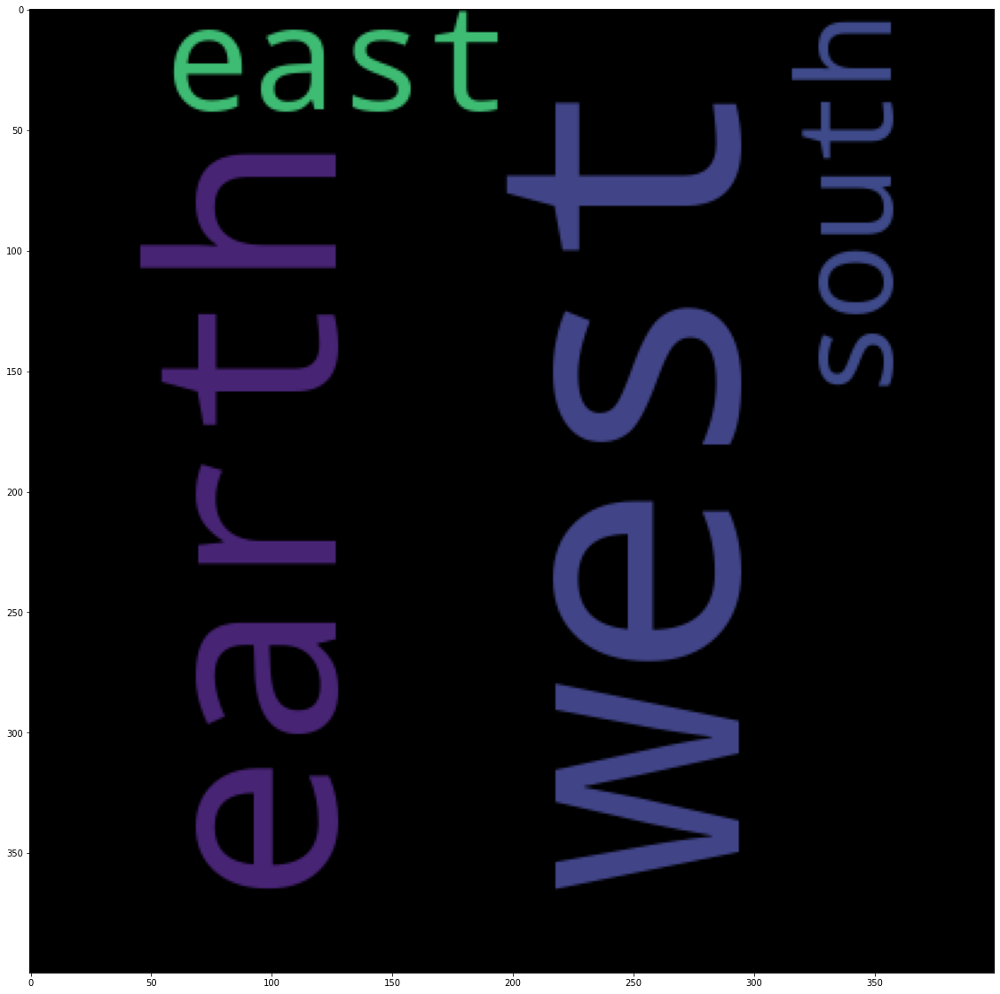

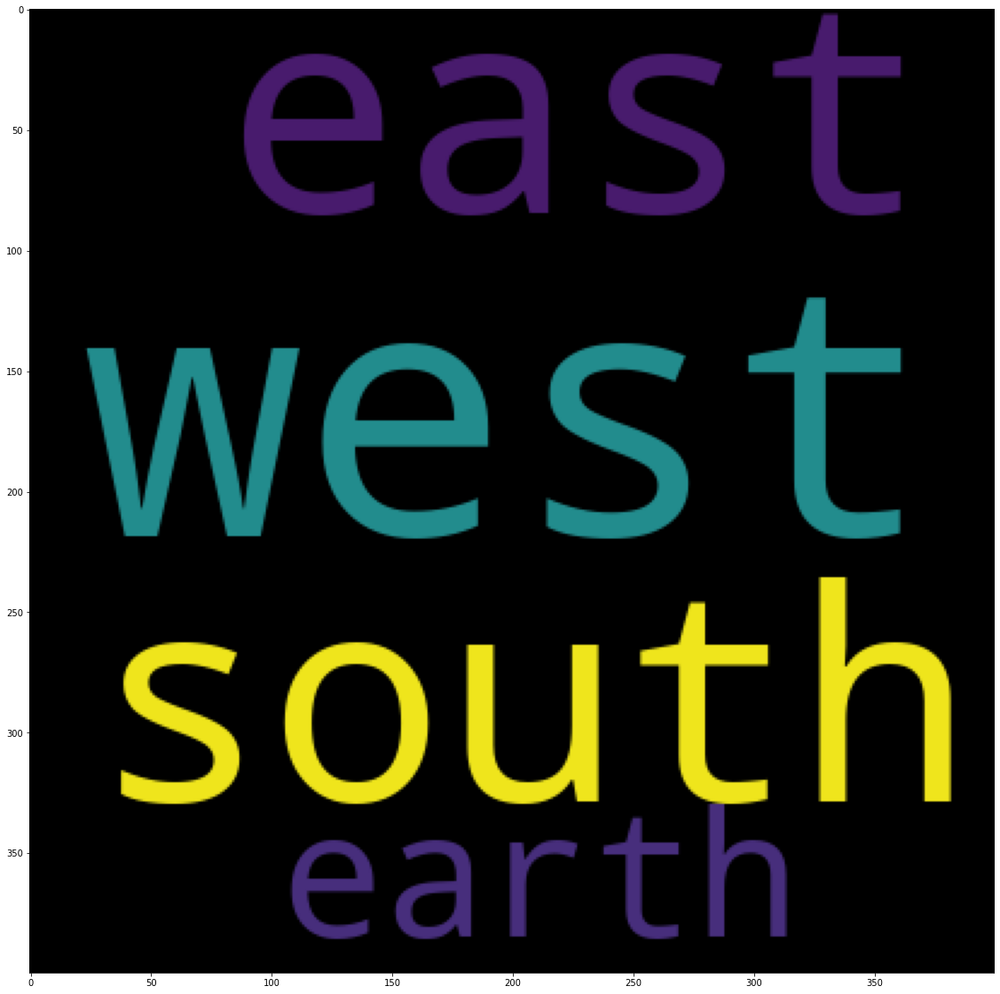

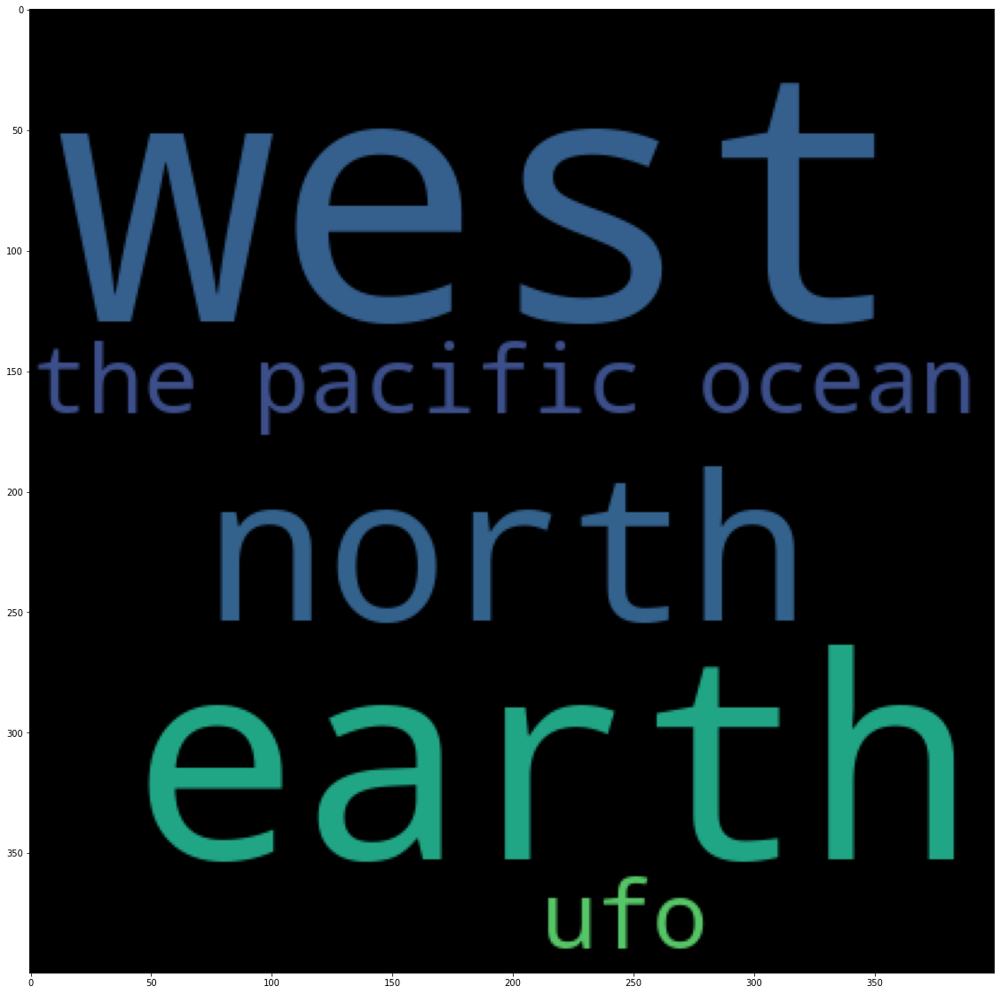

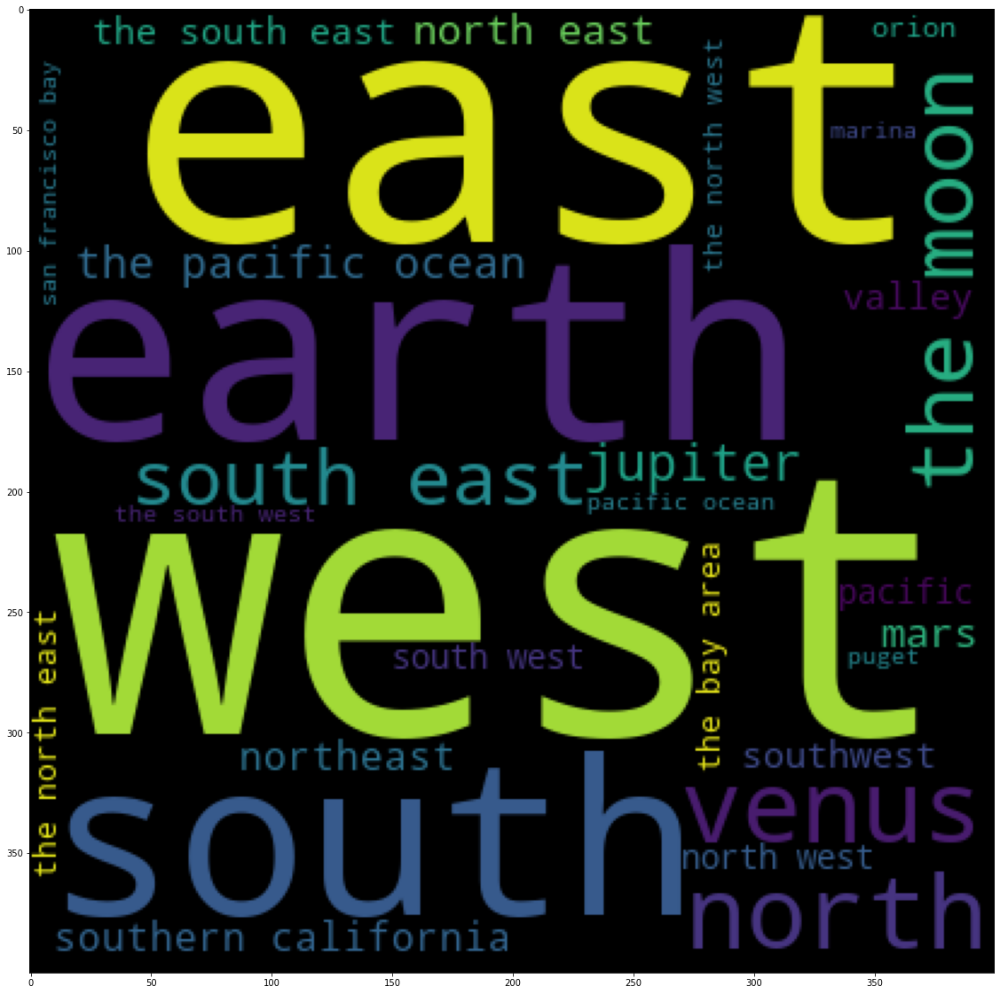

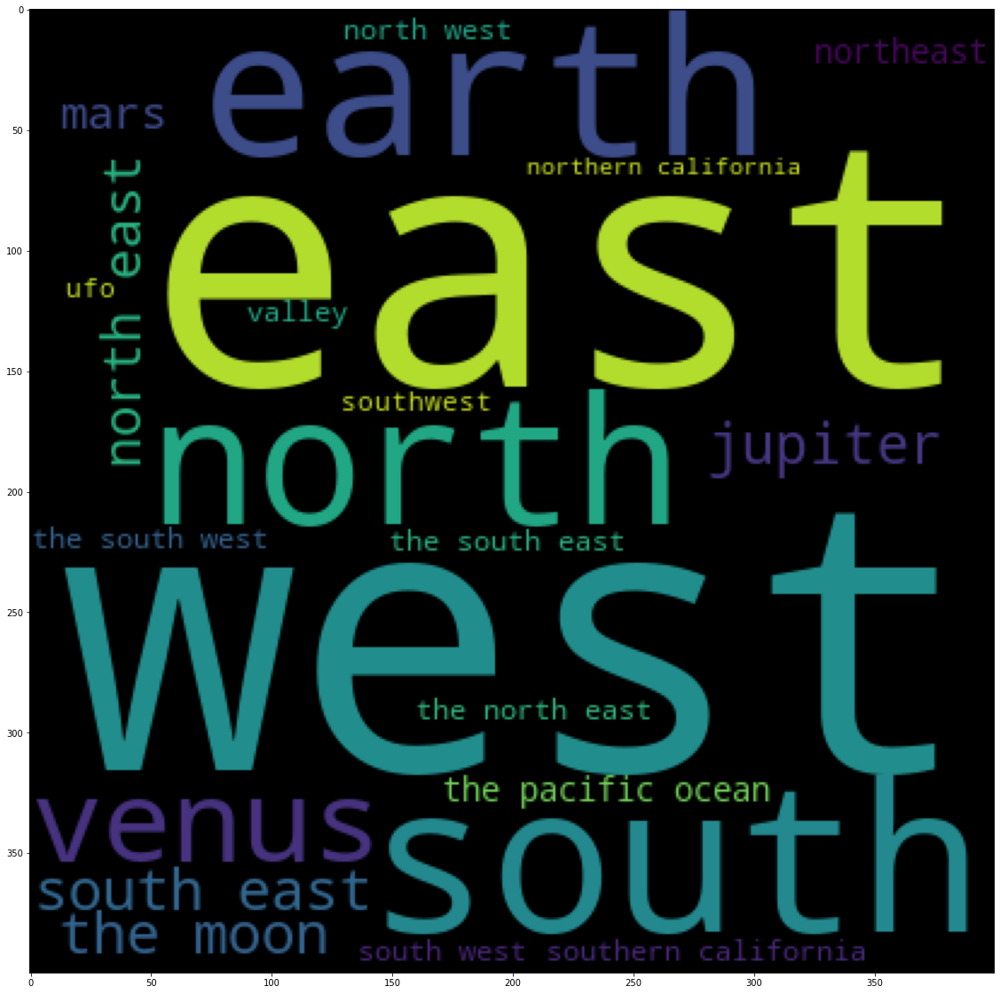

In [ ]:
decades = ['year 1969','70s','80s','90s','2000s','2010s']
for i in range(6):
  draw_entities_word_cloud("LOC",10,dicts[i],decades[i])

we see that as the decades progress people mention more planets like mars and venus

displaying value for:  year 1969
displaying value for:  70s
displaying value for:  80s
displaying value for:  90s
displaying value for:  2000s
displaying value for:  2010s


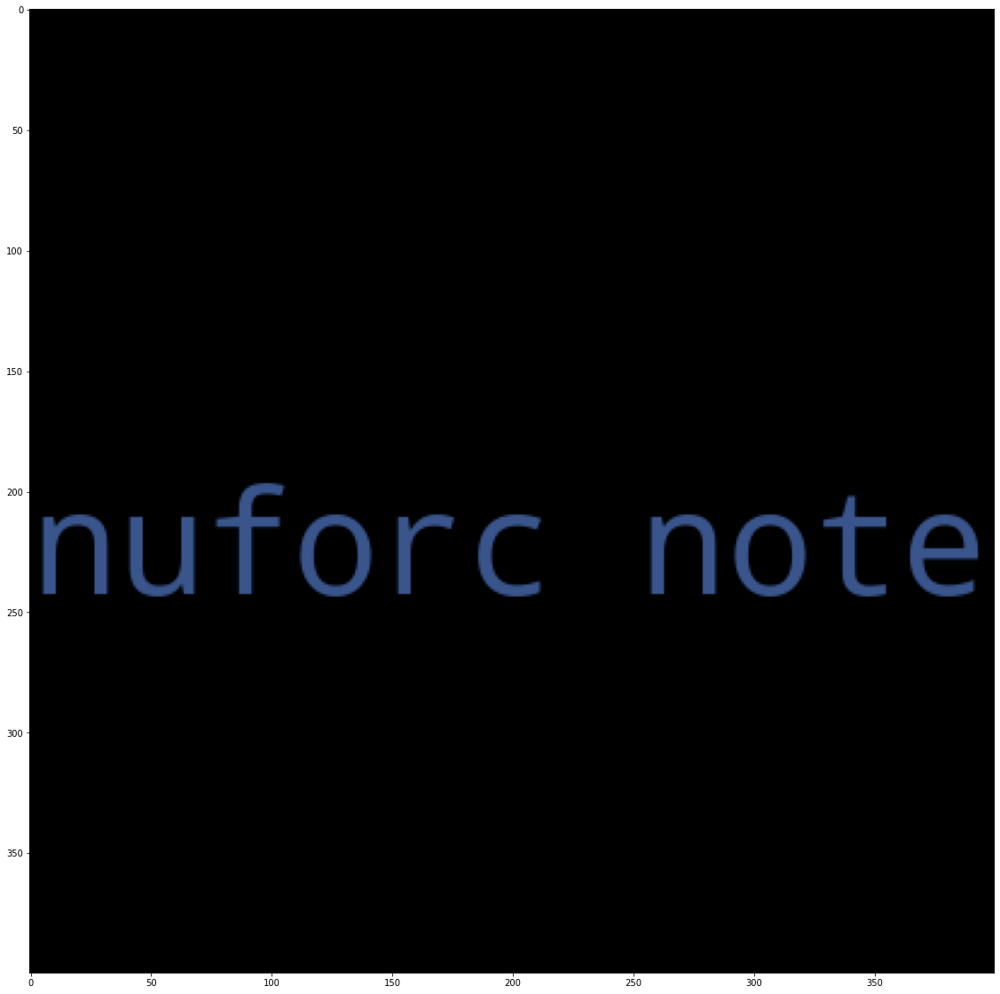

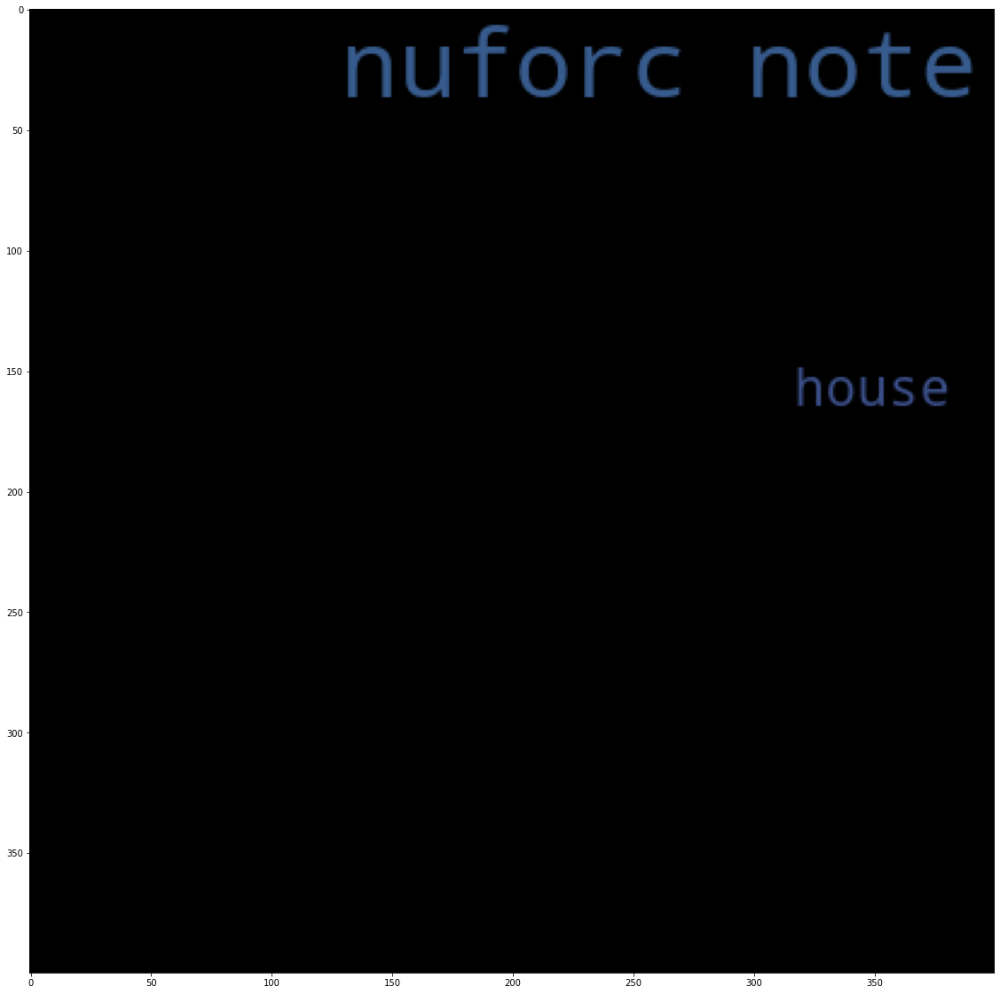

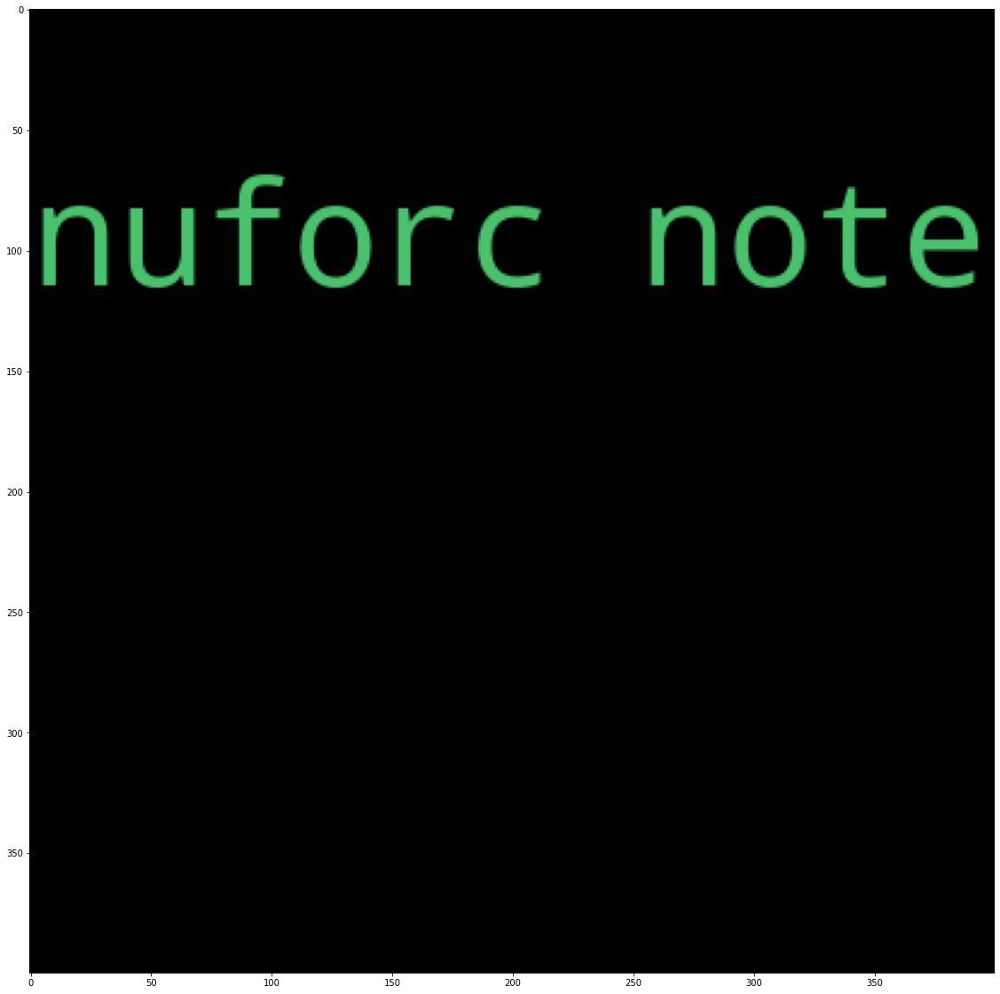

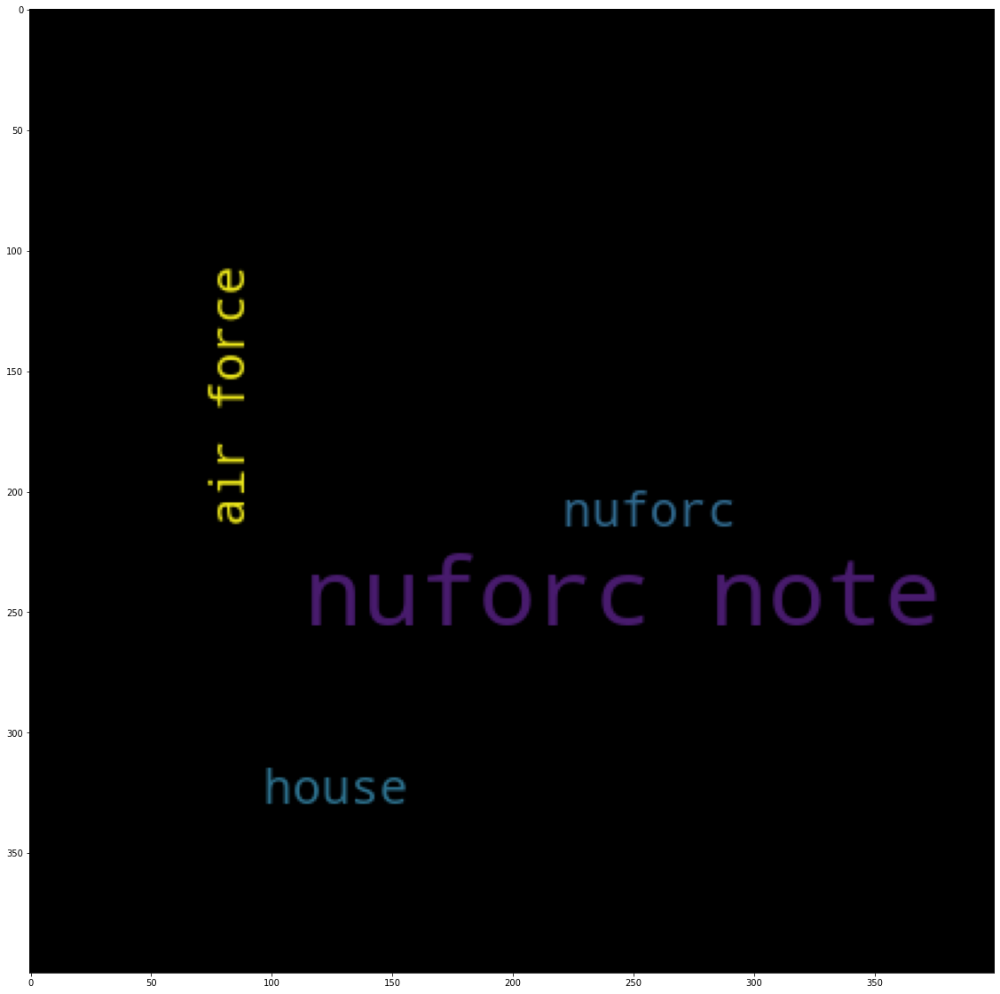

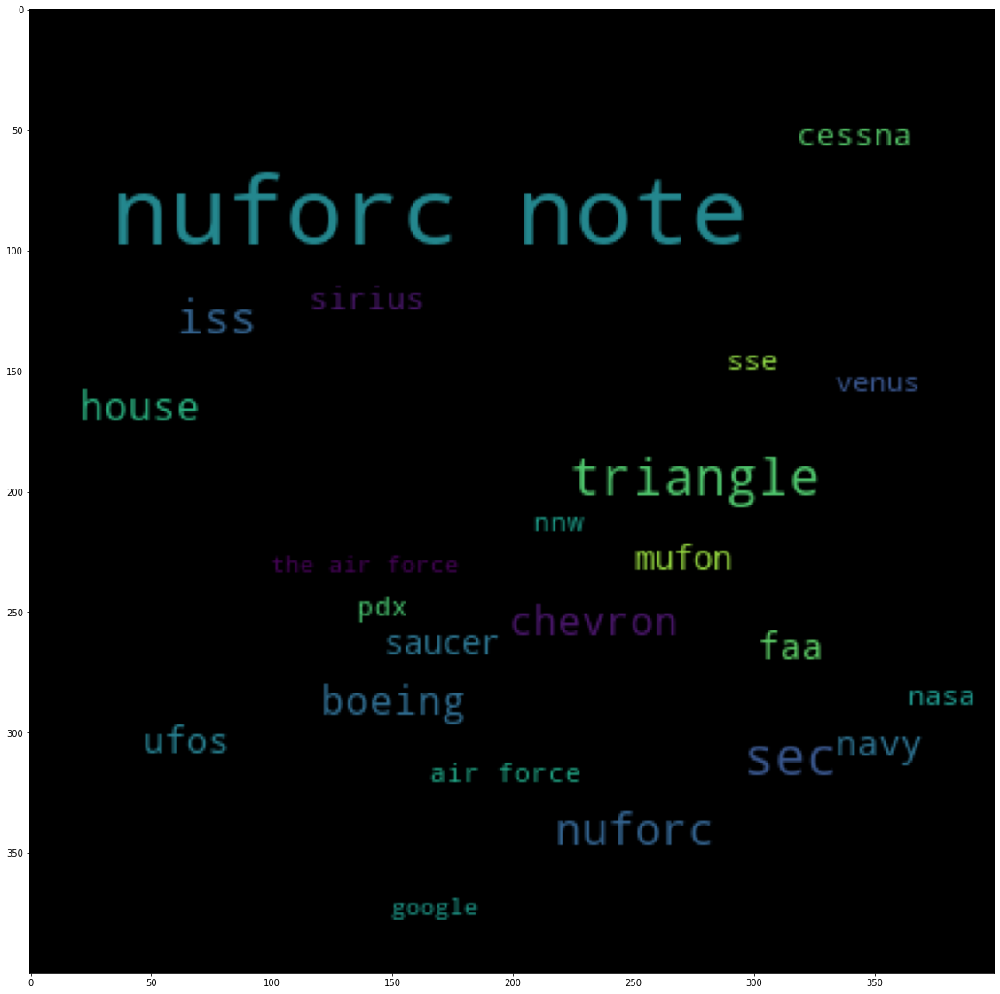

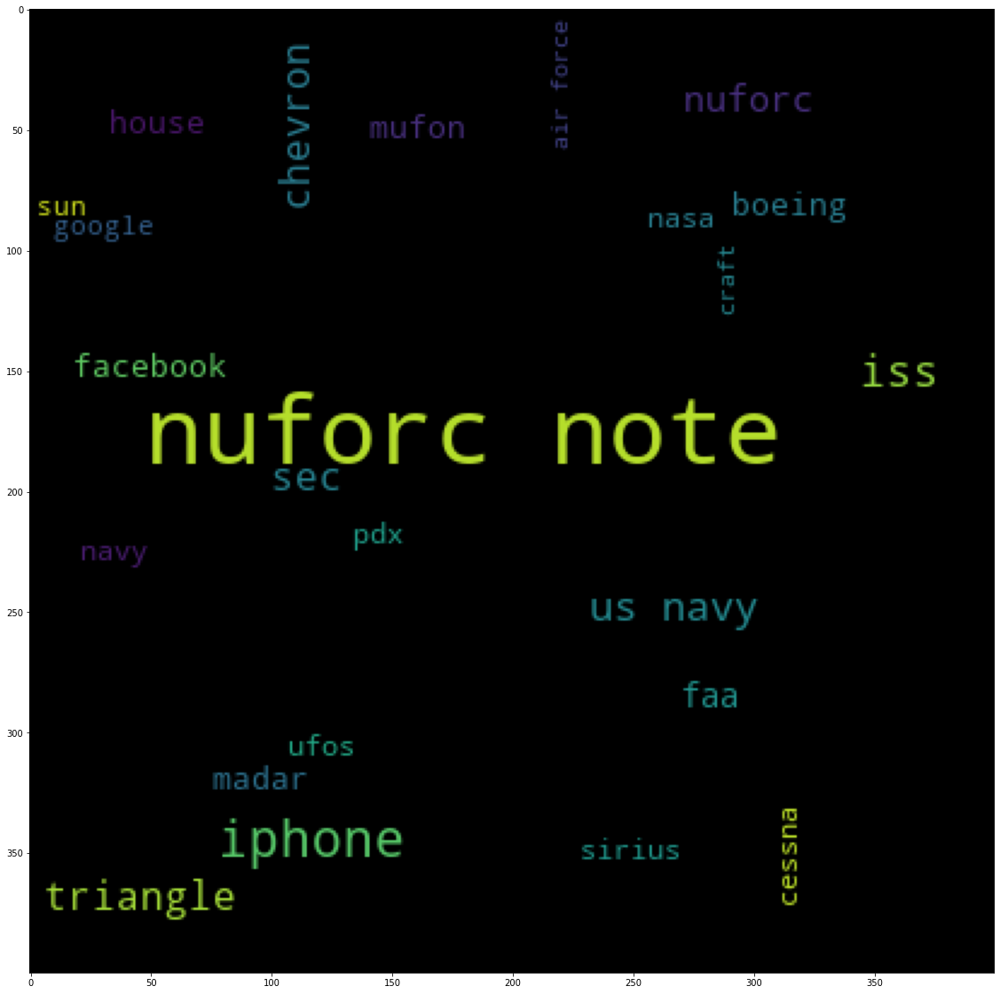

In [ ]:
decades = ['year 1969','70s','80s','90s','2000s','2010s']
for i in range(6):
  draw_entities_word_cloud("ORG",10,dicts[i],decades[i])

we see that every decade people mentioned nuforc.

on nuforc: https://www.lansingstatejournal.com/story/news/2021/07/08/lansing-michigan-unidentified-flying-object-ufo-sightings/7891403002/

no value for year 1969
no value for 70s
no value for 80s
displaying value for:  90s
displaying value for:  2000s
displaying value for:  2010s


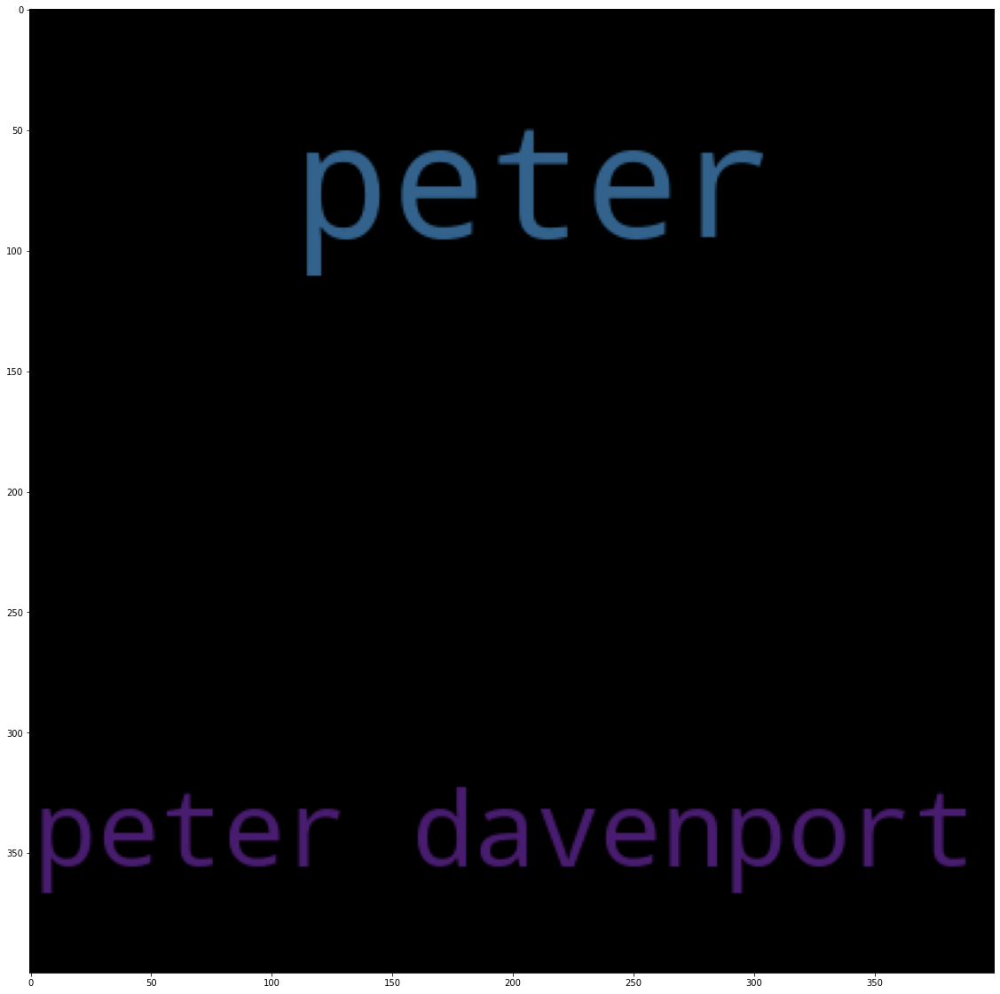

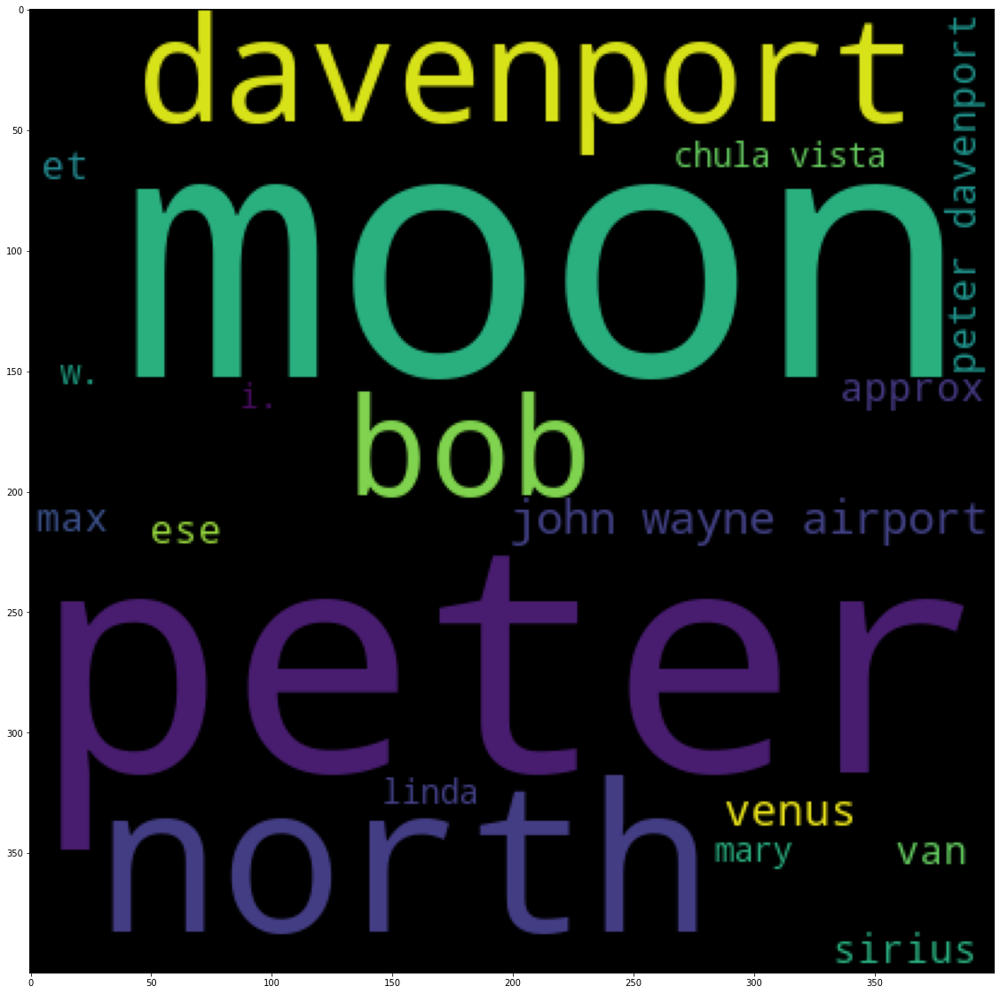

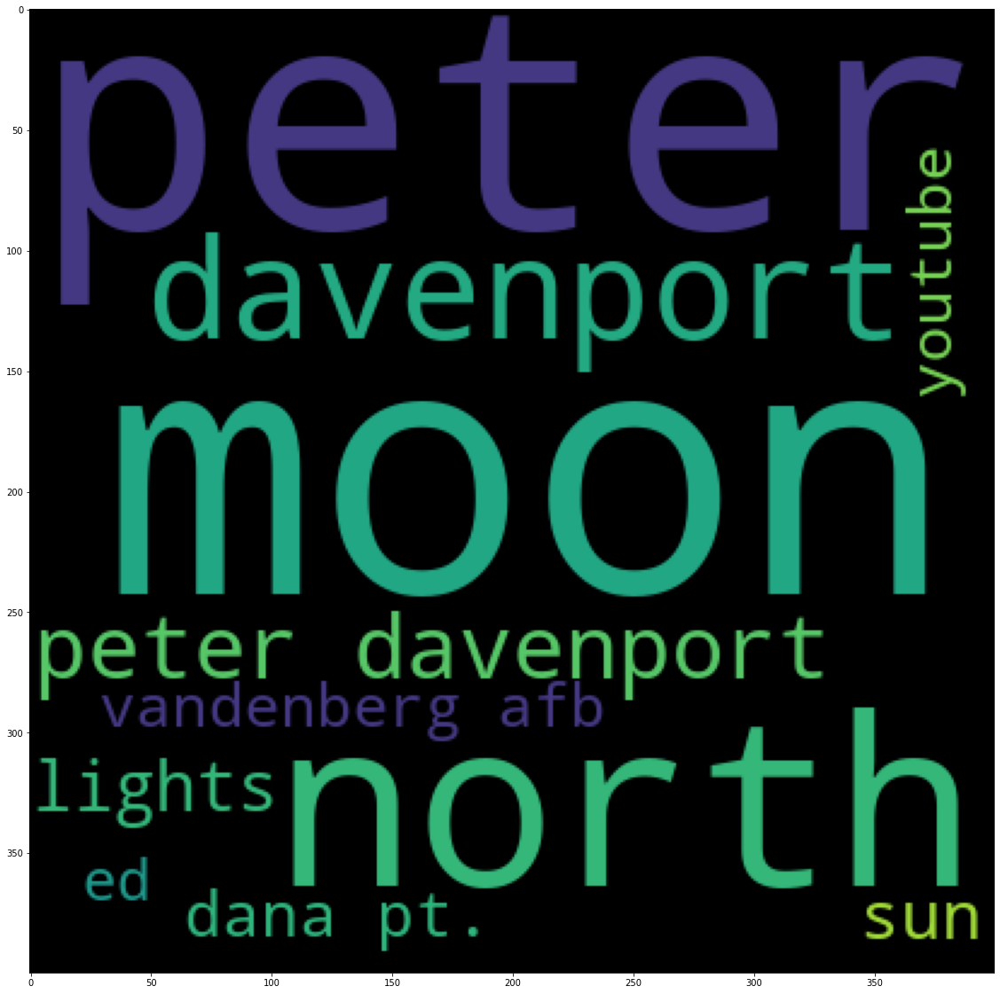

In [ ]:
for i in range(6):
  draw_entities_word_cloud("PERSON",10,dicts[i],decades[i])

we see that since the 70s people mention peter davenport.

on peter davenport : https://en.wikipedia.org/wiki/National_UFO_Reporting_Center

no value for year 1969
no value for 70s
no value for 80s
no value for 90s
displaying value for:  2000s
displaying value for:  2010s


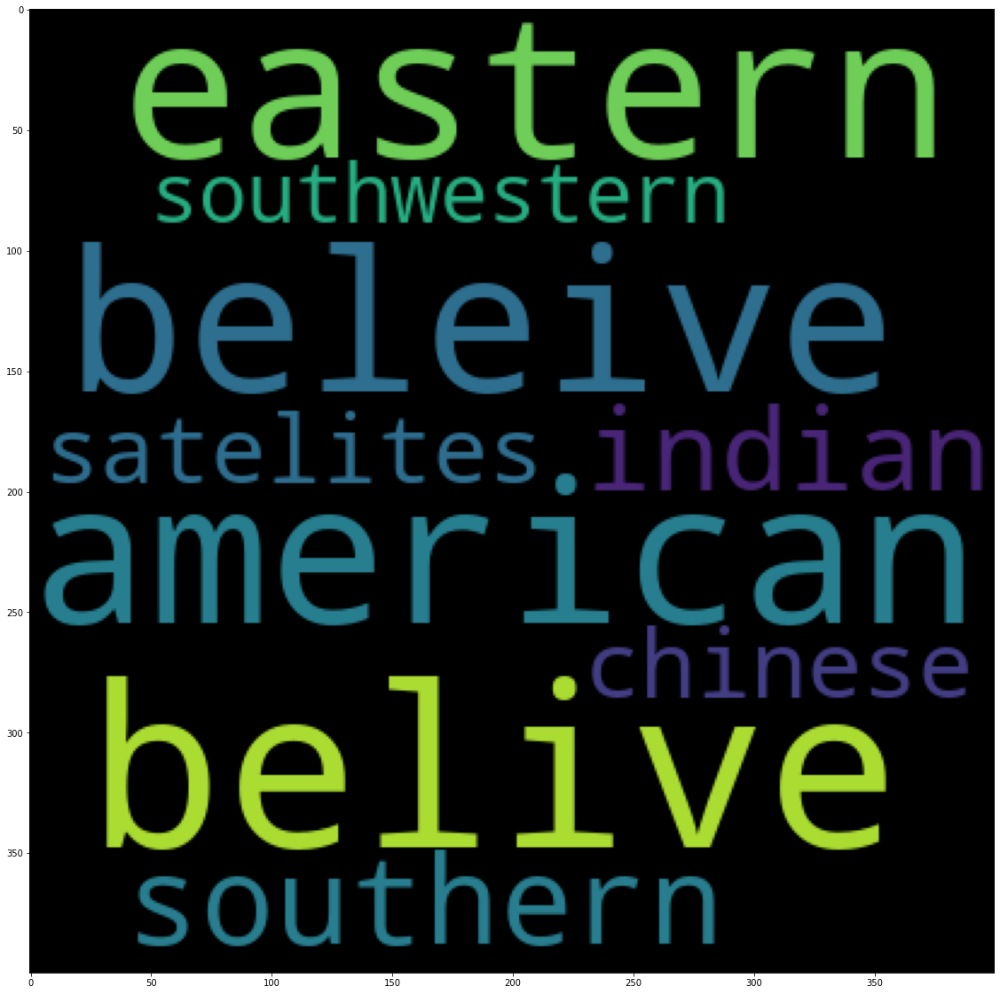

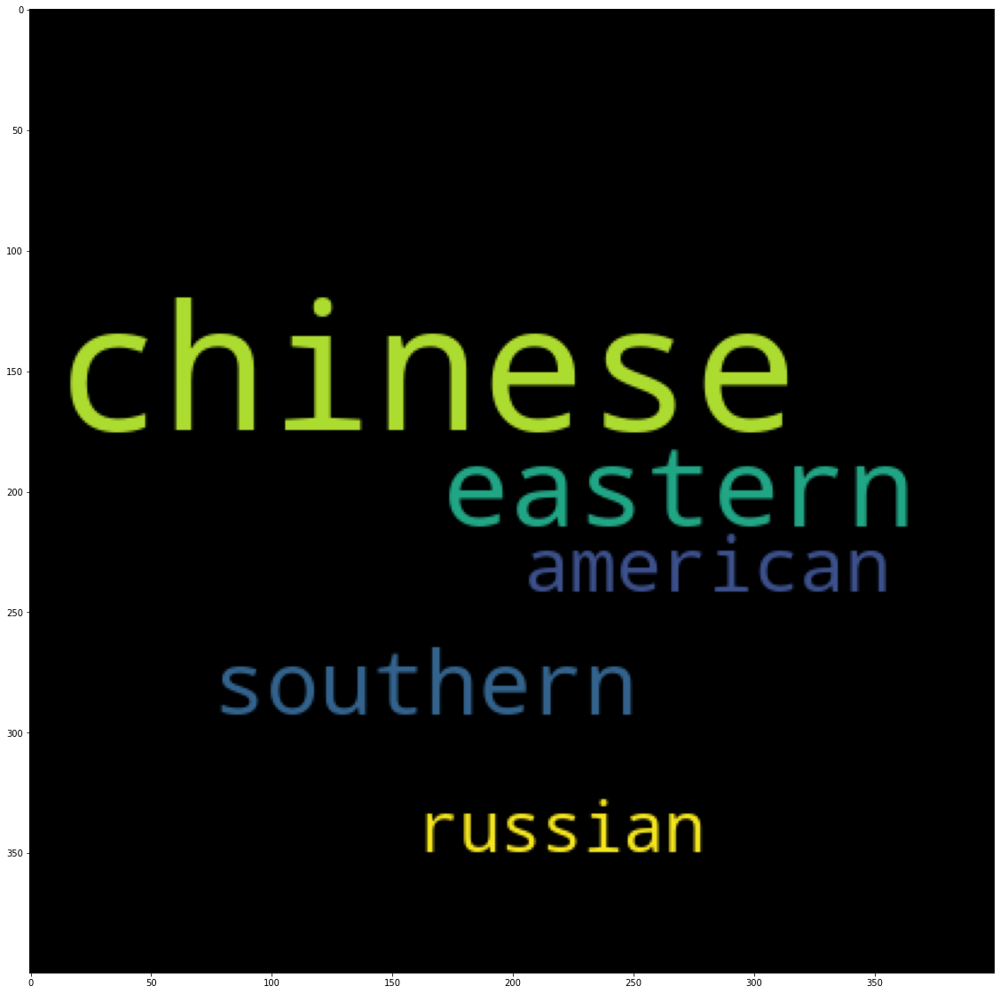

In [ ]:
for i in range(6):
  draw_entities_word_cloud("NORP",10,dicts[i],decades[i])

no value for year 1969
no value for 70s
no value for 80s
no value for 90s
displaying value for:  2000s
displaying value for:  2010s


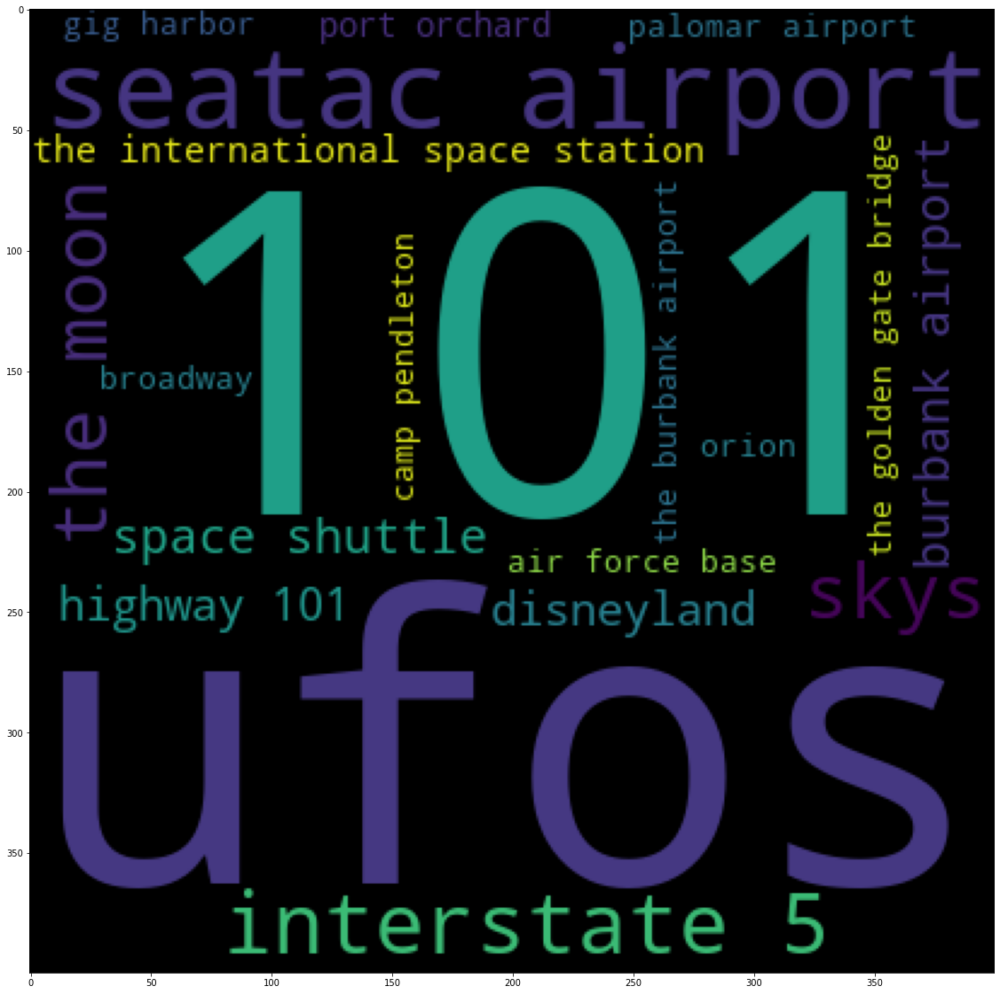

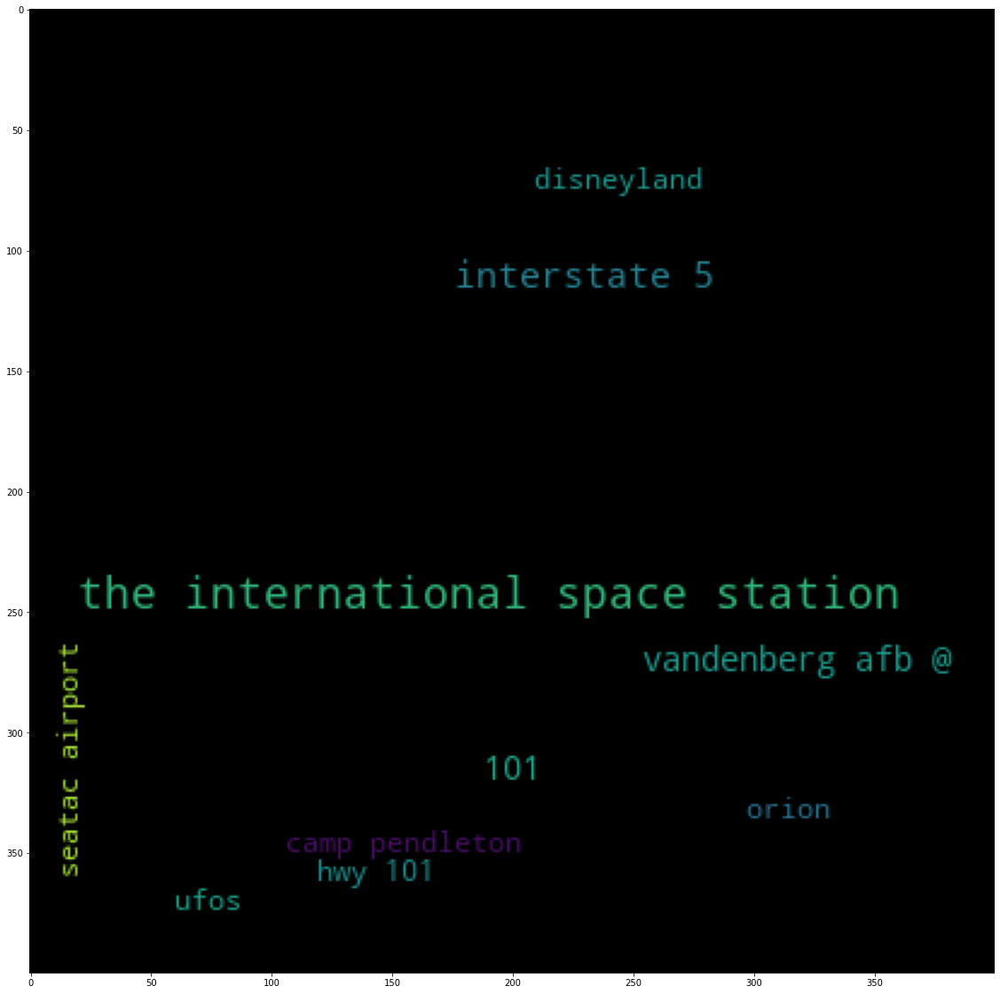

In [ ]:
for i in range(6):
  draw_entities_word_cloud("FAC",10,dicts[i],decades[i])

no value for year 1969
no value for 70s
no value for 80s
no value for 90s
displaying value for:  2000s
displaying value for:  2010s


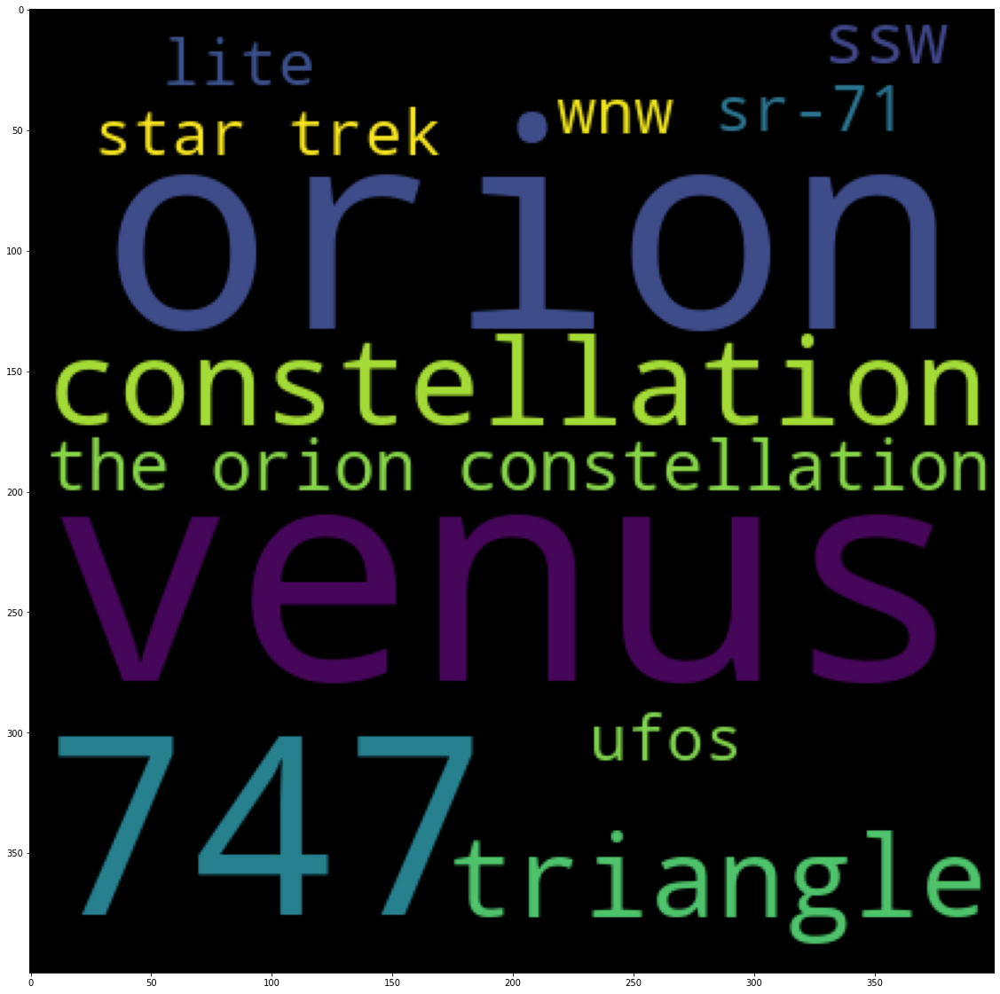

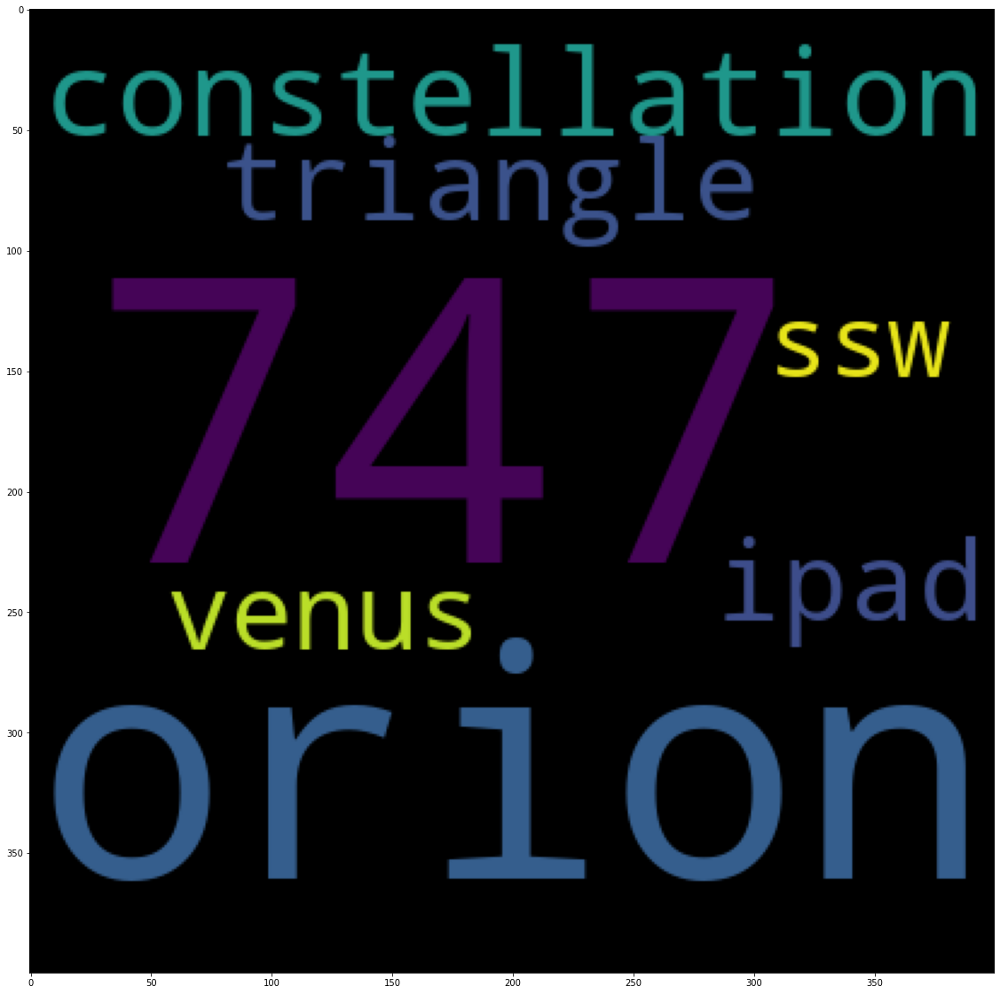

In [ ]:
for i in range(6):
  draw_entities_word_cloud("PRODUCT",10,dicts[i],decades[i])

no value for year 1969
displaying value for:  70s
displaying value for:  80s
displaying value for:  90s
displaying value for:  2000s
displaying value for:  2010s


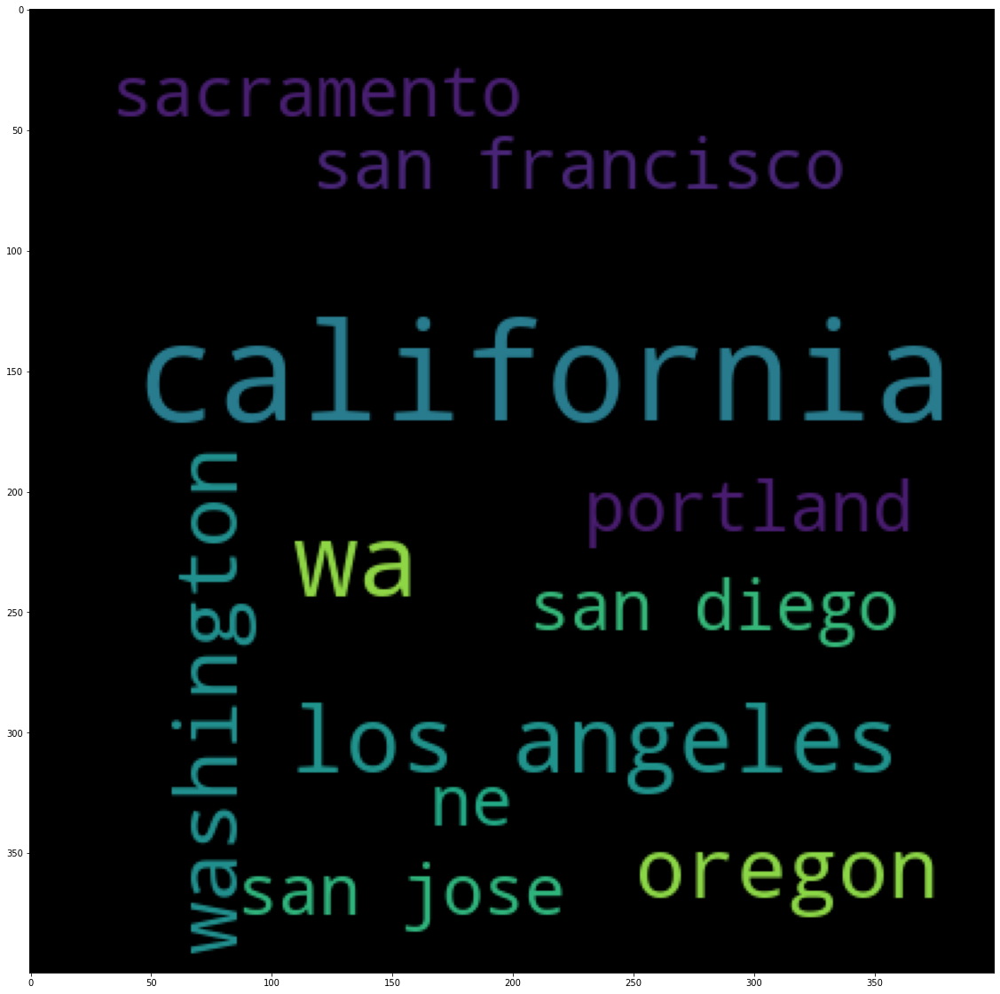

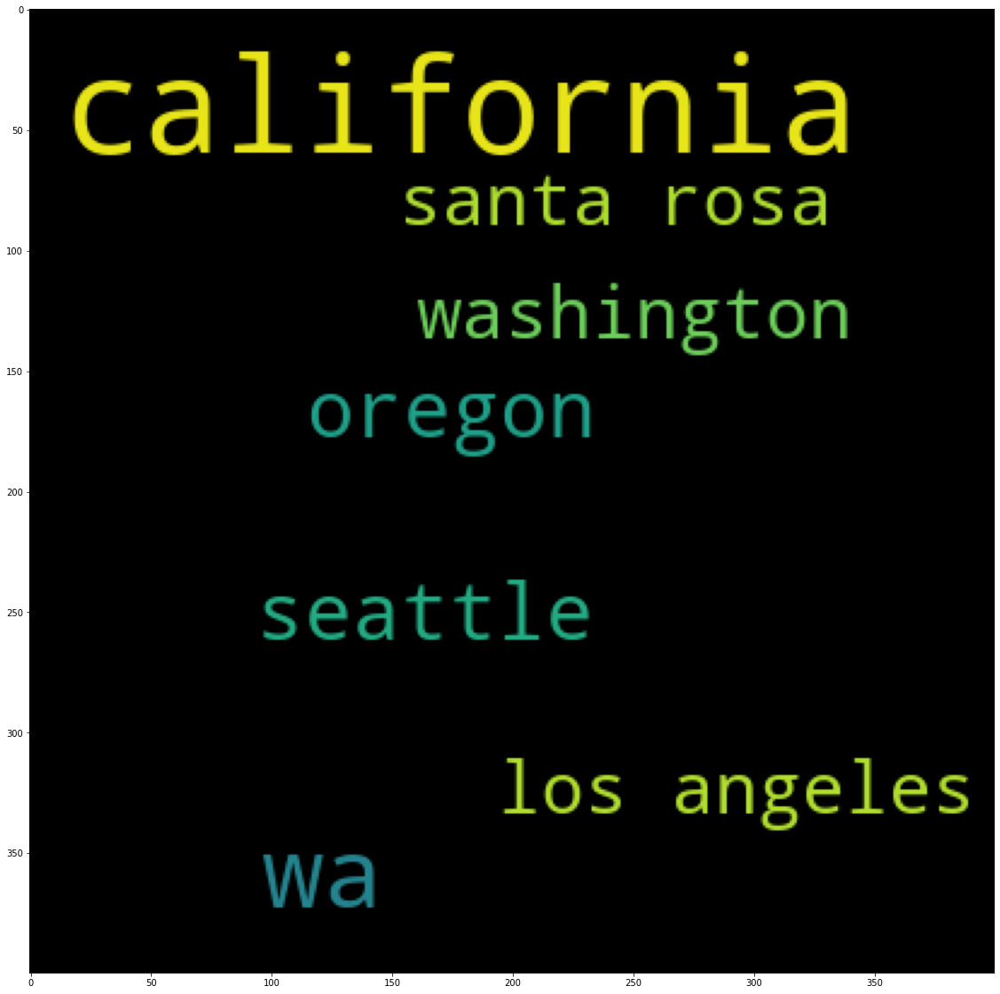

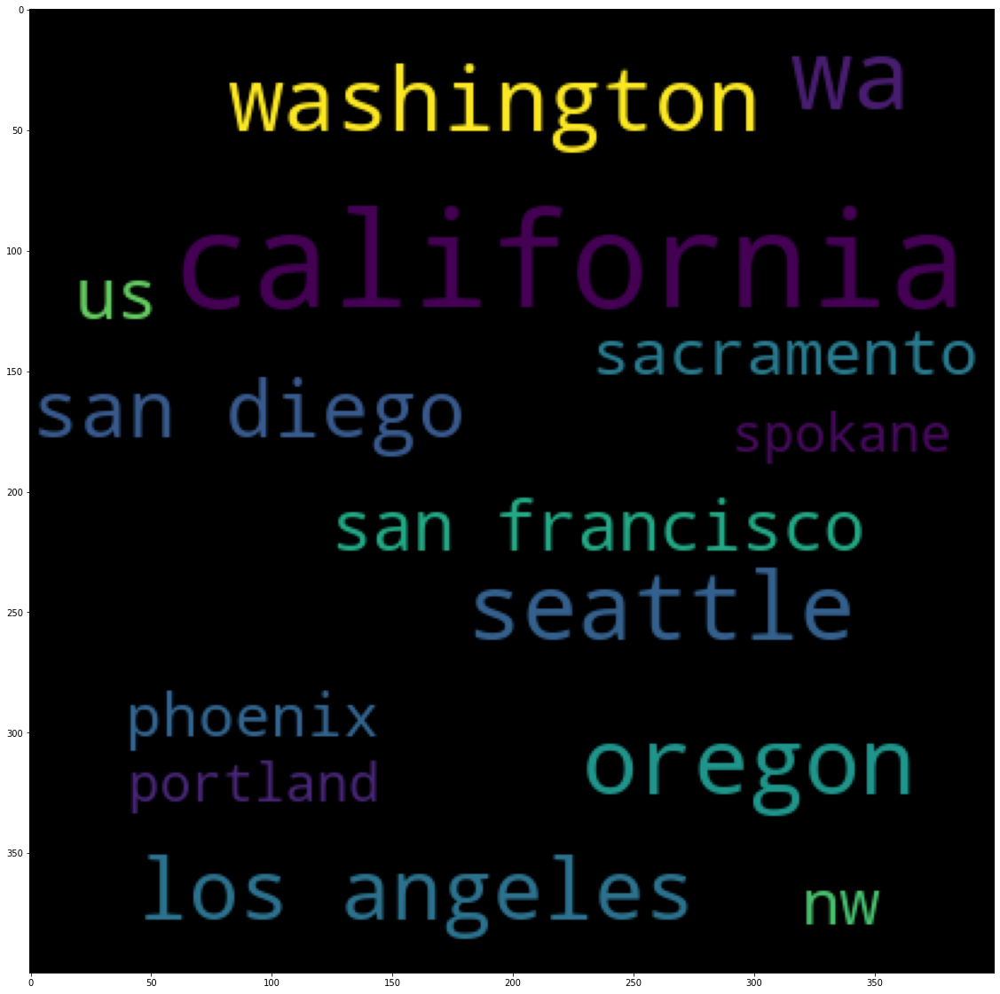

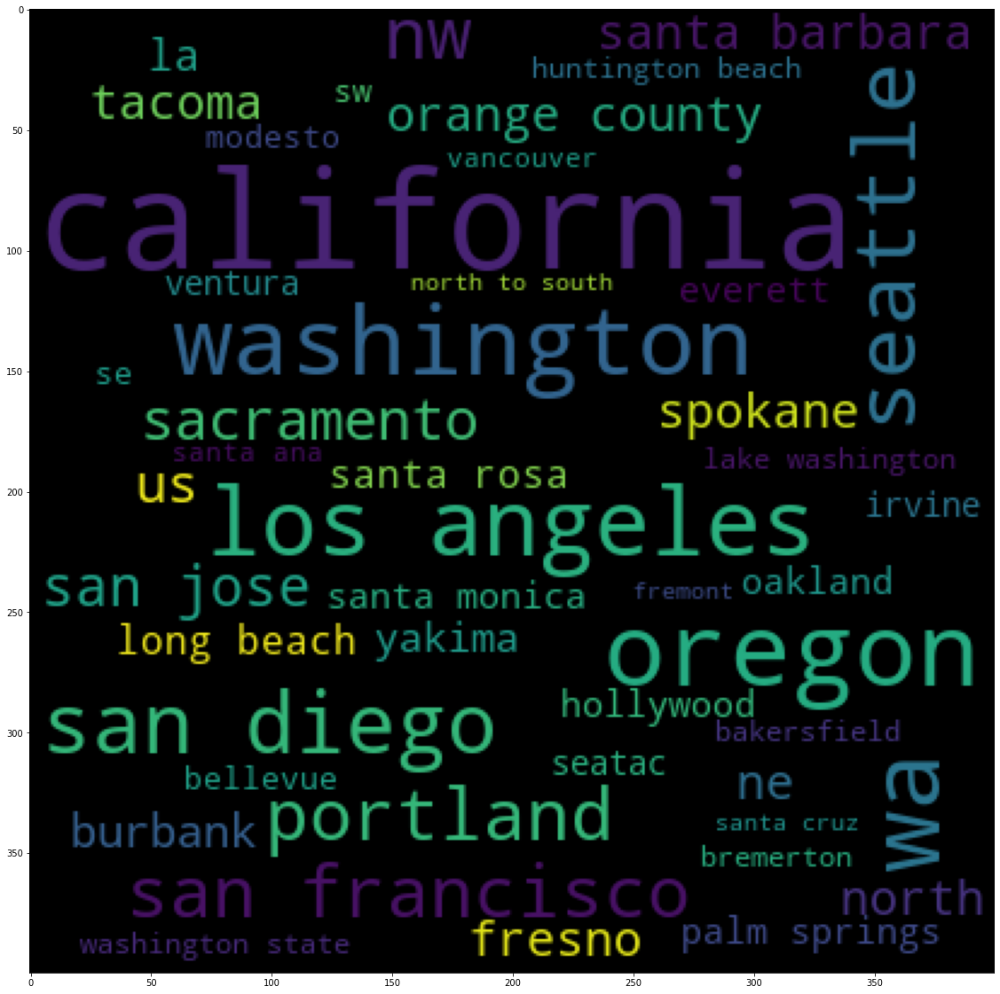

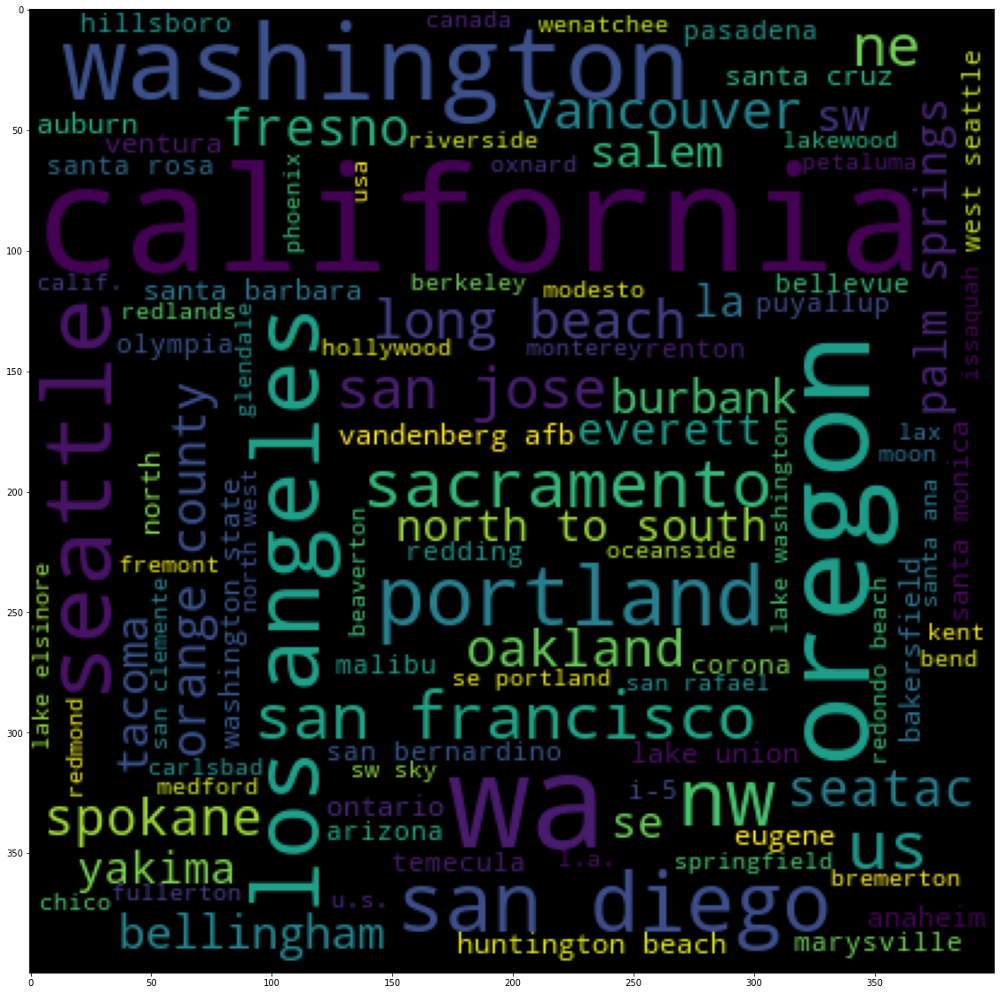

In [ ]:
for i in range(6):
  draw_entities_word_cloud("GPE",10,dicts[i],decades[i])

# **question 1 part 2**

show 2 ways to find encounters that are anomalies

##**option 1**

In [ ]:
#creating a vector of the text for each text and adding it to the sframe
l = []
for t in tqdm(sf_ufo_west_coast):
    l.append(nlp(t['text']).vector)

sf_ufo_west_coast['vector'] = l 

In [ ]:
#create unique id for each record
ID = []
for i in range(len(sf_ufo_west_coast)):
  ID.append(i)

sf_ufo_west_coast['ID'] = ID

In [ ]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE

#using TSNE to reduce the vector dimensions for visualization
X = []
for v in sf_ufo_west_coast['vector']:
    X.append(v)
X = np.array(X)
print("Computed X: ", X.shape)
X_embedded = TSNE(n_components=2, n_iter=250, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)

df = pd.DataFrame(columns=['x', 'y','ID'])
df['x'], df['y'] ,df['ID']= X_embedded[:,0], X_embedded[:,1],sf_ufo_west_coast['ID']
df

Computed X:  (13690, 300)
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 13690 samples in 0.568s...
[t-SNE] Computed neighbors for 13690 samples in 133.537s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13690
[t-SNE] Computed conditional probabilities for sample 2000 / 13690
[t-SNE] Computed conditional probabilities for sample 3000 / 13690
[t-SNE] Computed conditional probabilities for sample 4000 / 13690
[t-SNE] Computed conditional probabilities for sample 5000 / 13690
[t-SNE] Computed conditional probabilities for sample 6000 / 13690
[t-SNE] Computed conditional probabilities for sample 7000 / 13690
[t-SNE] Computed conditional probabilities for sample 8000 / 13690
[t-SNE] Computed conditional probabilities for sample 9000 / 13690
[t-SNE] Computed conditional probabilities for sample 10000 / 13690
[t-SNE] Computed conditional probabilities for sample 11000 / 13690
[t-SNE] Computed conditional probabilities for sample 12000 / 13690
[t-SNE] Computed condi

,x,y,ID
0,-0.166287,0.191968,0
1,-0.240103,0.282380,1
2,0.169160,-0.218472,2
3,-0.303021,0.359448,3
4,0.308997,-0.389597,4
...,...,...,...
13685,0.026235,-0.043611,13685
13686,-0.167784,0.193702,13686
13687,-0.047629,0.046741,13687
13688,-0.138612,0.157990,13688


In [ ]:
from matplotlib import pyplot as plt
import plotly.express as px
import turicreate.aggregate as agg
px.scatter(df,x="x", y="y")

here we have 2 clusters of anomalys. now we will find these 2 clusters by their coordinantes

In [ ]:
import turicreate as tc
def inRange(x,y):
  if 2 < y:
    return True
  elif 0.08 < x and y > 0:
    return True
  else:
    return False                                                                 
relevant = tc.SFrame(df)
relevant = relevant[relevant.apply(lambda r: inRange(r['x'],r['y']))]
relevant_description = relevant.join(sf_ufo_west_coast,on='ID',how='inner')
relevant_description = relevant_description['ID','text','x','y']
relevant_description

ID,text,x,y
242,MADAR Node 105,-0.02371213771402836,4.173088073730469
3969,Late at night in thesummer of 1979 a huge ...,0.09359036386013031,0.16051138937473297
8134,MADAR Node 105,-0.023612359538674355,4.175455570220947
8184,MADAR Node 105,-0.023629864677786827,4.172449111938477
8186,MADAR Node 105,-0.023623036220669746,4.171212196350098
8199,MADAR Node 105,-0.023669958114624023,4.174440860748291
8229,MADAR Node 105,-0.023634513840079308,4.172618865966797
8250,MADAR Node 105,-0.023620765656232834,4.175455570220947
8377,MADAR Node 105,-0.02362186275422573,4.172189712524414
8404,MADAR Node 105,-0.023780973628163338,4.172445774078369


In [ ]:
for text in relevant_description['text'].unique():
  print(text)

MADAR Node  105
Late at night in the summer of 1979 a huge chevron shapped UFO flew silently and slowly just above the rooftops of So. California I don’t remember the exact date, but it was several weeks into the first summer where my family was living (Rancho Palos Verdes, California) at the time I saw the craft, and that’s how I know approximately what month and year it was.  I was 11 years old at the time and I just learned to swim a few weeks earlier, and the first thing my dad taught me was to float because if I could float I would never be afraid of the water.  Floating in the pool and looking up at the stars at night quickly became one of my favorite things to do on hot summer nights.  This particular night very hot, even late into the evening it was still hot so I decided to cool off in the pool.  I turned off all the lights in the yard and only had the pool light turned on.  It was a perfect night for star gazing because it was a clear night with no clouds.  My dad and brother

we see 37 anomalies. most of them reference MADAR. 

madar website https://store.madar.site/

##**option 2**

In [ ]:
#use affin score to give a score to each text 
from afinn import Afinn
afinn = Afinn()

sf_ufo_west_coast['afinn_score'] = sf_ufo_west_coast['text'].apply(lambda t: afinn.score(t))

In [ ]:
sf_afinn_west_coast = sf_ufo_west_coast.groupby('afinn_score', {'count': agg.COUNT()}).sort('count')
sf_afinn_west_coast

afinn_score,count
-31.0,1
44.0,1
-24.0,1
74.0,1
38.0,1
76.0,1
-23.0,1
75.0,1
68.0,1
55.0,1


In [ ]:
#we can see that almost all scores are in the middle and those on the fringes have higher or lower scores and only appear once
for n in sf_afinn_west_coast.sort('afinn_score'):
  print(n)

{'afinn_score': -52.0, 'count': 1}
{'afinn_score': -31.0, 'count': 1}
{'afinn_score': -26.0, 'count': 2}
{'afinn_score': -24.0, 'count': 1}
{'afinn_score': -23.0, 'count': 1}
{'afinn_score': -22.0, 'count': 4}
{'afinn_score': -21.0, 'count': 6}
{'afinn_score': -20.0, 'count': 1}
{'afinn_score': -19.0, 'count': 4}
{'afinn_score': -18.0, 'count': 4}
{'afinn_score': -17.0, 'count': 2}
{'afinn_score': -16.0, 'count': 4}
{'afinn_score': -15.0, 'count': 9}
{'afinn_score': -14.0, 'count': 11}
{'afinn_score': -13.0, 'count': 8}
{'afinn_score': -12.0, 'count': 22}
{'afinn_score': -11.0, 'count': 17}
{'afinn_score': -10.0, 'count': 37}
{'afinn_score': -9.0, 'count': 51}
{'afinn_score': -8.0, 'count': 67}
{'afinn_score': -7.0, 'count': 98}
{'afinn_score': -6.0, 'count': 150}
{'afinn_score': -5.0, 'count': 234}
{'afinn_score': -4.0, 'count': 342}
{'afinn_score': -3.0, 'count': 531}
{'afinn_score': -2.0, 'count': 873}
{'afinn_score': -1.0, 'count': 1314}
{'afinn_score': 0.0, 'count': 1803}
{'afinn_

In [ ]:
#lets look at the anomalies
sf_afinn_west_coast = sf_afinn_west_coast[sf_afinn_west_coast['count'] == 1]
sf_afinn_west_coast

afinn_score,count
-31.0,1
44.0,1
-24.0,1
74.0,1
38.0,1
76.0,1
-23.0,1
75.0,1
68.0,1
55.0,1


In [ ]:
#there are only 16 scores that appeard once almost all of them are very high are very low scores
for score in sf_afinn_west_coast:
  print(score)

{'afinn_score': -52.0, 'count': 1}
{'afinn_score': 55.0, 'count': 1}
{'afinn_score': -23.0, 'count': 1}
{'afinn_score': 76.0, 'count': 1}
{'afinn_score': 74.0, 'count': 1}
{'afinn_score': 75.0, 'count': 1}
{'afinn_score': 51.0, 'count': 1}
{'afinn_score': 44.0, 'count': 1}
{'afinn_score': -24.0, 'count': 1}
{'afinn_score': 38.0, 'count': 1}
{'afinn_score': 68.0, 'count': 1}
{'afinn_score': -31.0, 'count': 1}
{'afinn_score': 43.0, 'count': 1}
{'afinn_score': 60.0, 'count': 1}
{'afinn_score': 59.0, 'count': 1}
{'afinn_score': -20.0, 'count': 1}


In [ ]:
#lets find these records and add them to data list
data = []

for r in sf_ufo_west_coast:
  if r['afinn_score'] in sf_afinn_west_coast['afinn_score']:
    data.append(r)

In [ ]:
#disply the results of these anomalies
from turicreate import SFrame
import pandas as pd
df = pd.DataFrame(data) 
sf_afinn_anomaly = SFrame(data=df)
sf_afinn_anomaly

summary,city,state,date_time,shape,duration
Diamond or Pyramid shapedcraft sighted in Los ...,Monrovia,CA,1988-10-15T15:45:00,diamond,3 minutes
A car struck an invisibleobject causing the ca ...,Cerritos,CA,1975-06-01T12:00:00,,1-2 minutes
Three unexplained eventsexperienced March 28th ...,Roseville,CA,2009-03-28T02:00:00,formation,35-45 minute
Two sightings of the sameobject within 22 hours ...,Hat Creek,CA,2010-06-27T00:00:00,diamond,10-15 seconds
"UFO Sighting September14, 2011. ...",Lodi,CA,2011-09-14T00:00:00,light,25 Minutes
"6 extremely brightlights, surrounding a ...",Irvine,CA,2012-09-03T16:45:00,cylinder,about 9 minutes
"Two UFOS seen by askeptic in Felton, CA. ...",Felton,CA,2012-11-24T02:50:00,oval,2-3 minutes
HUGE Ball Shape withWhite Light Ring ...,Redlands,CA,2019-09-26T04:45:00,sphere,90 seconds
UFO caused earthquakes?,Bellingham,WA,1980-12-12T20:40:00,fireball,Unknown
blue silicon craft -cigar shape - est. size ...,Gig Harbor,WA,2001-09-01T19:00:00,cigar,2 min


In [ ]:
#showing the positive anomalies
print('postive anomalies encounters: ')
for r in sf_afinn_anomaly:
  if r['afinn_score'] >= 0:
    print(r['text'])

postive anomalies encounters: 
Diamond or Pyramid shaped craft sighted in Los Angeles County, in the fall of 1988 PREFACE:  It never really occurred to me until recently that I could submit this UFO report ‘retroactively’ because it describes an event that took place in 1988 when I was about 9 years old — and that I probably should go ahead and upload it, as my tiny contribution to the greater good, as part of the historical record — As I’ve heard many times, that for all those who witness something unusual in the sky, only a mere fraction actually take the time to report it. Herein contained is the one and only unusual event that I’ve experienced, or sighted, that can only be described as a “UFO” — I’ve never seen anything even remotely close to this before, or since. It was a benchmark moment that was permanently burned into my memory and I can recall it today, as clearly I could on the day it happened.  Even then, at the time, I had no doubt that what I was observing was something e

In [ ]:
#showing the negative anomalies
print('negative anomalies encounters: ')
for r in sf_afinn_anomaly:
  if r['afinn_score'] < 0:
    print(r['text'])

negative anomalies encounters: 
A car struck an invisible object causing the car to come to a complete stop. Around 1975 while living in Southern California I encountered a very strange occurrence.  Like the Northbrook, Illinois incident I witnessed a vehicle hit an invisible object.  I was sitting at a stop light with one other car that was directly across from me, also waiting for the light to change.  I heard a crash and looked up to see a car that was traveling from right to left had come to a complete stop just short of the intersection.   Steam was spewing from the radiator and it had a large dent in the grill.  It was like the car hit a pole but there was no pole.  I saw nothing that could have caused this. The next thing I knew the light had changed and I proceeded through the intersection slowly.  It felt like a dream and I was just along for the ride.  I remember starring at that car and even looking over at the other car that was proceeding through the intersection across fr

# **question 1 part 3**

choose a state, show how the duration of the encounter and the place changed over the centuries

In [ ]:
#i have chosen arizona
sf_UFO_Arizona = sf_UFO[sf_UFO['state'] == 'AZ']
sf_UFO_Arizona

summary,city,state,date_time,shape,duration
Description is the sameas Washington DC even ...,Tucson,AZ,2019-05-01T11:00:00,unknown,5 minutes
Apr. 10th we witnessed avery bright silvery r ...,Gold Canyon,AZ,2019-04-10T17:00:00,circle,10 minutes
Mother and two childrenrecall ufo experience ...,Phoenix,AZ,1979-08-20T21:00:00,disk,5 minutes
one fireball in the skythen 3 black shapes come ...,Phoenix,AZ,1986-07-13T18:00:00,fireball,20mins
PHOENIX LIGHT OVERSCOTTSDALE IN 1991 ...,Scottsdale,AZ,1990-06-30T20:30:00,triangle,10 MINUTES
3-8 stationary silverobjects in the area of ...,Tucson,AZ,2019-03-14T15:55:00,other,5 minutes
I thought it was a redlight on a helicopter. ...,Peoria,AZ,2019-03-16T20:30:00,light,5-10 minutes
Formation of small witelights moving across the ...,Green Valley,AZ,2019-03-19T19:30:00,formation,1 minute
Mother Ship/ Appeared asa Star. ((NUFORC Note: ...,Tucson,AZ,1996-07-15T23:00:00,other,Hours
Viewed a light yellowish-orange somewhat ...,Mesa,AZ,1997-02-28T23:00:00,triangle,30 seconds


In [ ]:
g = sf_UFO_Arizona.groupby('decade', {'number of UFO sights': agg.COUNT()}).sort('decade')
g

decade,number of UFO sights
1969,2
"2000s, between 2000 and2010 ...",604
"2010s, between 2010 and2020 ...",1802
"70s, between 1970 and1980 ...",17
"80s,between 1980 and 1990",26
"90s, between 1990 and2000 ...",77


In [ ]:
#now we will display ufo sighting by decade, each decade will appear as a different color 
import folium
from folium import FeatureGroup ,LayerControl

tiles = 'Stamen Terrain'
m = folium.Map(location=[34.436088, -111.697119], zoom_start=6.9,
               tiles = tiles)

sf_UFO_all_decades = []
sf_UFO_all_feature_groups = []

#create different sframes for each decade
sf_UFO_69 = sf_UFO_Arizona[sf_UFO_Arizona['year'] == '1969']
sf_UFO_70s = sf_UFO_Arizona[sf_UFO_Arizona['decade'] == '70s, between 1970 and 1980']
sf_UFO_80s = sf_UFO_Arizona[sf_UFO_Arizona['decade'] == '80s,between 1980 and 1990']
sf_UFO_90s = sf_UFO_Arizona[sf_UFO_Arizona['decade'] == '90s, between 1990 and 2000']
sf_UFO_2000s = sf_UFO_Arizona[sf_UFO_Arizona['decade'] =='2000s, between 2000 and 2010']
sf_UFO_2010s = sf_UFO_Arizona[sf_UFO_Arizona['decade'] =='2010s, between 2010 and 2020']

#add the to a list
sf_UFO_all_decades.append(sf_UFO_69)
sf_UFO_all_decades.append(sf_UFO_70s)
sf_UFO_all_decades.append(sf_UFO_80s)
sf_UFO_all_decades.append(sf_UFO_90s)
sf_UFO_all_decades.append(sf_UFO_2000s)
sf_UFO_all_decades.append(sf_UFO_2010s)

#create different feature groups to disply at different times
feature_group_69 = FeatureGroup(name="1969")
feature_group_70s = FeatureGroup(name="70s")
feature_group_80s = FeatureGroup(name="80s")
feature_group_90s = FeatureGroup(name="90s")
feature_group_2000s = FeatureGroup(name="2000s")
feature_group_2010s = FeatureGroup(name="2010s")

sf_UFO_all_feature_groups.append(feature_group_69)
sf_UFO_all_feature_groups.append(feature_group_70s)
sf_UFO_all_feature_groups.append(feature_group_80s)
sf_UFO_all_feature_groups.append(feature_group_90s)
sf_UFO_all_feature_groups.append(feature_group_2000s)
sf_UFO_all_feature_groups.append(feature_group_2010s)



colors = ['darkred','blue','green','black','purple','red']
decades = ['year 1969','70s','80s','90s','2000s','2010s']

#function to disply 
def display_map(sf,feature_group,color,decade):
  for r in sf:
    folium.CircleMarker(location=[r['city_latitude'],r['city_longitude']],
                        radius=5,color=color, popup='the '+decade+' a total of: ' + str(len(sf))+ ' sightings', parse_html=True).add_to(feature_group)

#call the map display function for each decade
for count,sf_ufo in enumerate(sf_UFO_all_decades):
  display_map(sf_ufo,sf_UFO_all_feature_groups[count],colors[count],decades[count])


#add feature groups to the folium map
feature_group_69.add_to(m)
feature_group_70s.add_to(m)
feature_group_80s.add_to(m)
feature_group_90s.add_to(m)
feature_group_2000s.add_to(m)
feature_group_2010s.add_to(m)
folium.LayerControl().add_to(m)
m  

above is an intractive map, at the top right are buttons for options. 

each color represents a different decade and clicking on the places shows aditional inforamtion

In [ ]:
sf_UFO_Arizona['duration'] = sf_UFO_Arizona['duration'].apply(lambda r: r.lower())

In [ ]:
#for each record, parse the duration into 4 catagories: seconds,minutes, hours and unclear
def parse_time(r):
  if 'min' in r:
    return 'minutes'
  if 'sec' in r:
    return 'seconds'
  if 'hour' in r or 'hr' in r:
    return 'hours'
  else:
    return 'unclear'

sf_UFO_Arizona['duration_clean'] = sf_UFO_Arizona['duration'].apply(lambda r: parse_time(r))

In [ ]:
#we have a nice distribution of times
g = sf_UFO_Arizona.groupby('duration_clean', {'number of UFO sights': agg.COUNT()}).sort('duration_clean')
g

duration_clean,number of UFO sights
hours,159
minutes,1558
seconds,570
unclear,241


In [ ]:
#add percent to each sframe to display aditional information in the next map
def get_percent(r,g):
  percent = (len(g[g['duration_clean'] == r['duration_clean']])*100)/len(g)
  percent = '{0:.2f}'.format(percent)+'%'
  return percent

sf_UFO_69['percent'] = sf_UFO_69.apply(lambda r: get_percent(r,sf_UFO_69))
sf_UFO_70s['percent'] = sf_UFO_70s.apply(lambda r: get_percent(r,sf_UFO_70s))
sf_UFO_80s['percent'] = sf_UFO_80s.apply(lambda r: get_percent(r,sf_UFO_80s))
sf_UFO_90s['percent'] = sf_UFO_90s.apply(lambda r: get_percent(r,sf_UFO_90s))
sf_UFO_2000s['percent'] = sf_UFO_2000s.apply(lambda r: get_percent(r,sf_UFO_2000s))
sf_UFO_2010s['percent'] = sf_UFO_2010s.apply(lambda r: get_percent(r,sf_UFO_2010s))


In [ ]:
import branca.colormap as cm
#display legend in the top right
colormap = cm.LinearColormap(colors=['blue','green','red','black'])
colormap = colormap.to_step(index=[1, 2, 3, 4,5])
colormap.caption =  'SECONDS..............MINUTES................HOURS...............UNKNOWN'

tiles = 'Stamen Terrain'
m = folium.Map(location=[34.436088, -111.697119], zoom_start=6.9,
               tiles = tiles)


sf_UFO_all_feature_groups = []
feature_group_69_new = FeatureGroup(name="1969")
feature_group_70s_new = FeatureGroup(name="70s")
feature_group_80s_new = FeatureGroup(name="80s")
feature_group_90s_new = FeatureGroup(name="90s")
feature_group_2000s_new = FeatureGroup(name="2000s")
feature_group_2010s_new = FeatureGroup(name="2010s")

sf_UFO_all_feature_groups.append(feature_group_69_new)
sf_UFO_all_feature_groups.append(feature_group_70s_new)
sf_UFO_all_feature_groups.append(feature_group_80s_new)
sf_UFO_all_feature_groups.append(feature_group_90s_new)
sf_UFO_all_feature_groups.append(feature_group_2000s_new)
sf_UFO_all_feature_groups.append(feature_group_2010s_new)

#function to give each marker a different color by its duration
def get_color_AZ(r):
  if r['duration_clean'] == 'seconds':
    return 'blue'
  if r['duration_clean'] == 'minutes':
    return 'green'
  if r['duration_clean'] == 'hours':
    return 'red'
  else:
    return 'black'


def display_map(sf,feature_group):
  for r in sf:
    folium.CircleMarker(location=[r['city_latitude'],r['city_longitude']],
                        radius=5,color=get_color_AZ(r), popup='duration: '  + r['duration'] + ' ,' + r['percent'] + ' of sighting this year were '+ r['duration_clean']
                        , parse_html=True).add_to(feature_group)


for count,sf_ufo in enumerate(sf_UFO_all_decades):
  display_map(sf_ufo,sf_UFO_all_feature_groups[count])
   

feature_group_69_new.add_to(m)
feature_group_70s_new.add_to(m)
feature_group_80s_new.add_to(m)
feature_group_90s_new.add_to(m)
feature_group_2000s_new.add_to(m)
feature_group_2010s_new.add_to(m)
folium.LayerControl().add_to(m)
colormap.add_to(m)
m  

above is an intractive map, at the top right are buttons for options. 

each color represents a different incounter duration. 
you can see for each decade how many different duration incounters were, and their perent of total incounters that decade.

# **question 2 part 1**

show where and when it isnt recommended to eat

In [ ]:
!mkdir ./datasets
!mkdir ./datasets/sf-restaurant-inspection

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d datasf/sf-restaurant-inspection-scores -p ./datasets/sf-restaurant-inspection

!unzip ./datasets/sf-restaurant-inspection/*.zip  -d ./datasets/sf-restaurant-inspection

mkdir: cannot create directory ‘./datasets’: File exists
mkdir: cannot create directory ‘./datasets/sf-restaurant-inspection’: File exists
  0% 0.00/3.42M [00:00<?, ?B/s]
100% 3.42M/3.42M [00:00<00:00, 113MB/s]
Archive:  ./datasets/sf-restaurant-inspection/sf-restaurant-inspection-scores.zip
  inflating: ./datasets/sf-restaurant-inspection/Restaurant_Scores_-_LIVES_Standard.csv  
  inflating: ./datasets/sf-restaurant-inspection/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.dbf  
  inflating: ./datasets/sf-restaurant-inspection/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.prj  
  inflating: ./datasets/sf-restaurant-inspection/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.shp  
  inflating: ./datasets/sf-restaurant-inspection/Shapefiles (2)/Analysis Neighborhoods/geo_export_7c3449d4-91cf-4b41-8929-3a62ae10c1ca.shx  
  inflating: ./datasets/sf-restaurant-inspection/Shap

In [ ]:
import turicreate as tc
import turicreate.aggregate as agg

sf_inspections = tc.SFrame.read_csv('/content/datasets/sf-restaurant-inspection/Restaurant_Scores_-_LIVES_Standard.csv')
sf_inspections = sf_inspections.dropna()
sf_inspections

Finished parsing file /content/datasets/sf-restaurant-inspection/Restaurant_Scores_-_LIVES_Standard.csv

Parsing completed. Parsed 100 lines in 0.587791 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,str,str,str,str,int,float,float,str,int,str,str,int,str,str,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Unable to interpret "CA" as a integer
Parse failed at token ending at: 
	81376,Trilogi SF,425 Barneveld Ave,San Francisco,CA,CA,^,,,+14155313475,81376_20141210,12/10/2014 12:00:00 AM,,New Ownership,,,
Successfully parsed 5 tokens: 
	0: 81376
	1: Trilogi SF
	2: 425 Barneveld Ave
	3: San Francisco
	4: CA

Unable to interpret "Ca" as a integer
Parse failed at token ending at: 
	88143,Yemen Kitchen,219 Jones St,San Francisco,CA,Ca,^,,,+14155213575,88143_20160812,08/12/2016 12:00:00 AM,,New Ownership,,,
Successfully parsed 5 tokens: 
	0: 88143
	1: Yemen Kitchen
	2: 219 Jones St
	3: San Francisco
	4: CA

Unable to interpret "Ca" as a integer
Parse failed at token ending at: 
	88143,Yemen Kitchen,219 Jones St,San Francisco,CA,Ca,^,,,+14155213575,88143_20160922,09/22/2016 12:00:00 AM,,New Ownership,,,
Successfully parsed 5 tokens: 
	0: 88143
	1: Yemen Kitchen
	2: 219 Jones St
	3: San Francisco
	4: CA

Unable to interpret "CA" as a integer
Parse failed at token ending at: 
	64738,Japacurry,Public,San Francisco,CA,CA,^37.777122,-122.419639,"(37.777122, -122.419639)",,64738_20150306,03/06/2015 12:00:00 AM,89,Routine - Unscheduled,64738_20150306_103120,Moderate risk food holding temperature,Moderate Risk
Successfully parsed 5 tokens: 
	0: 64738
	1: Japacurry
	2: Public
	3: San Francisco
	4: CA

Unable to interpret "CA" as a integer
Parse failed at token ending at: 
	64738,Japacurry,Public,San Francisco,CA,CA,^37.777122,-122.419639,"(37.777122, -122.419639)"
Successfully parsed 5 tokens: 
	0: 64738
	1: Japacurry
	2: Public
	3: San Francisco
	4: CA

Unable to interpret "CA" as a integer
Parse failed at token ending at: 
	64738,Japacurry,Public,San Francisco,CA,CA,^37.777122,-122.419639,"(37.777122, -122.419639)"
Successfully parsed 5 tokens: 
	0: 64738
	1: Japacurry
	2: Public
	3: San Francisco
	4: CA

Unable to interpret "CA" as a integer
Parse failed at token ending at: 
	64738,Japacurry,Public,San Francisco,CA,CA,^37.777122,-122.419639,"(37.777122, -122.419639)",,64738_20140506,05/06/2014 12:00:00 AM,83,Routine - Unscheduled,64738_20140506_103129,Insufficient hot water or running water,Moderate Risk
Successfully parsed 5 tokens: 
	0: 64738
	1: Japacurry
	2: Public
	3: San Francisco
	4: CA

Unable to interpret "Ca" as a integer
Parse failed at token ending at: 
	88139,Tacolicious,2250 Chestnut St,San Francisco,CA,Ca,^,,,+14155646077,88139_20161121,11/21/2016 12:00:00 AM,83,Routine - Unscheduled,88139_20161121_103133,Foods not protected from contamination,Moderate Risk
Successfully parsed 5 tokens: 
	0: 88139
	1: Tacolicious
	2: 2250 Chestnut St
	3: San Francisco
	4: CA

Unable to interpret "Ca" as a integer
Parse failed at token ending at: 
	88139,Tacolicious,2250 Chestnut St,San Francisco,CA,Ca,^,,,+14155646077,88139_20161121,11/21/2016 12:00:00 AM,83,Routine - Unscheduled,88139_20161121_103145,Improper storage of equipment utensils or linens,Low Risk
Successfully parsed 5 tokens: 
	0: 88139
	1: Tacolicious
	2: 2250 Chestnut St
	3: San Francisco
	4: CA

Unable to interpret "CA" as a integer
Parse failed at token ending at: 
	64738,Japacurry,Public,San Francisco,CA,CA,^37.777122,-122.419639,"(37.777122, -122.419639)",,64738_20150306,03/06/2015 12:00:00 AM,89,Routine - Unscheduled,64738_20150306_103102,Unclean hands or improper use of gloves,High Risk
Successfully parsed 5 tokens: 
	0: 64738
	1: Japacurry
	2: Public
	3: San Francisco
	4: CA

30 lines failed to parse correctly

Finished parsing file /content/datasets/sf-restaurant-inspection/Restaurant_Scores_-_LIVES_Standard.csv

Parsing completed. Parsed 53525 lines in 0.364744 secs.

business_id,business_name,business_address,business_city,business_state,business_postal_code
4864,DRAGON CITY BAKERY & CAFE,2367 MISSION St,San Francisco,CA,94110
5813,LICK MIDDLE SCHOOL,1220 Noe St,San Francisco,CA,94114
6348,Castro Street Chevron,2399 Market St,San Francisco,CA,94114
5813,LICK MIDDLE SCHOOL,1220 Noe St,San Francisco,CA,94114
64380,Michael Mina Restaurant,252 California St,San Francisco,CA,94111
5623,AT&T - DOGGIE DINNER Room5310 [145153] ...,24 5624 Pl,San Francisco,CA,94107
4787,TONY BALONEY'S,1098 HOWARD St,San Francisco,CA,94103
33700,Casa Guadalupe #3,2999 MISSION,San Francisco,CA,94110
5631,AT&T -Room 5331 GILROYGARLIC FRIES/view ...,24 WILLIE MAYS PLAZA5.24.02 ...,San Francisco,CA,94107
5633,AT&T - FIELD CLUBCONCESSION [145185] ...,24 WILLIE MAYS PLAZA1.09.04 ...,San Francisco,CA,94107


In [ ]:

from matplotlib import pyplot as plt
import plotly.express as px
import turicreate.aggregate as agg
g = sf_inspections.groupby('inspection_score', {'count of scores': agg.COUNT()}).sort('inspection_score')
g = g.to_dataframe()
fig = px.bar(g, y='inspection_score', x='count of scores', color='inspection_score',title='score counts',orientation='h')
fig.update_layout(
    autosize=False,
    width=750,
    height=1000,)
fig.update_yaxes(nticks=102)


In [ ]:
#create dictionary to hold average score of each business
g =  sf_inspections.groupby('business_name', {'avg of scores': agg.AVG('inspection_score')})
g = g.to_dataframe()
g = g.to_dict('split')['data']
g = dict(g)
g

{'17th & Noe Market': 97.5,
 '2001 THAI STICK': 86.5,
 '21 Taste House': 89.25,
 '23rd & Guerrero Market & Deli': 96.66666666666667,
 '260 Golden Gate Family Residence': 96.0,
 '5 Degree Tea House': 92.15384615384616,
 '7-ELEVEN STORE 2230-23342E': 94.4,
 '7-Eleven #2366-35663A': 92.0,
 '7-Eleven Food Store': 96.66666666666667,
 '7-Mission Restaurant': 82.66666666666667,
 'A&M LIQUOR': 98.0,
 'A-1 BAKERY': 88.57142857142857,
 'A16': 92.28571428571429,
 "ABE'S MARKET": 98.0,
 'ABSINTHE BRASSERIE & BAR': 91.0,
 "ACE WASABI'S ROCK N ROLL SUSHI": 86.4,
 'AFC SUSHI @ SAFEWAY 1507': 91.14285714285714,
 "AFC SUSHI at Mollie Stone's #10": 96.0,
 'AFC Sushi @ Safeway #1490': 99.0,
 'AK SUBS': 85.72727272727273,
 'ALBORZ': 78.76470588235294,
 "ALI BABA'S CAVE RESTAURANT": 88.0,
 'ALICE FONG YU ELEMENTARY SCHOOL': 94.375,
 'ALPHA MARKET': 89.6,
 'ALVARADO ELEMENTARY SCHOOL': 92.33333333333333,
 'ANCHOR OYSTER BAR INC.': 93.66666666666667,
 'ANDERSEN BAKERY': 97.0,
 'ANZU Restaurant': 83.818181818

In [ ]:
#add the average to the sframe
sf_inspections['avg'] = sf_inspections['business_name'].apply(lambda name: g[name])
sf_inspections.sort('business_name')

business_id,business_name,business_address,business_city,business_state,business_postal_code,business_latitude
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104


In [ ]:
#create folium map to display the places with the lowest average score.
import folium
m = folium.Map(location=[37.750276, -122.428989], zoom_start=11.5
               )

counter = {}
for r in sf_inspections:
        counter[r['business_name']] =0


for r in sf_inspections:
      #chose the lowest avg scores
      if r['avg'] < 70:
        
        counter[r['business_name']] = counter[r['business_name']] + 1
        folium.Marker(
            location=[r['business_latitude'],r['business_longitude']],
            popup= f"<b>number of violations: {counter[r['business_name']]}<b>, business name: {r['business_name']}<b>, avg inspection score: {r['avg']}, risk: {r['risk_category']},latest violation : {r['violation_description']}" ,
            icon=folium.Icon(color='darkred', icon='fa-coffee',prefix='fa')
        ).add_to(m)
m

In [ ]:
#folium map to display places with most violations
import folium
m = folium.Map(location=[37.750276, -122.428989], zoom_start=11.5
               )

#count the violations
counter_2 = {}
for r in sf_inspections:
        counter_2[r['business_name']] =0
for r in sf_inspections:
        counter_2[r['business_name']] = counter_2[r['business_name']] + 1

counter_2 = sorted(counter_2.items(), key=lambda x:x[1],reverse=True)
#chose the top 40 with most violations
counter_2 = counter_2[:40]

#determine color by number of violations
def get_color2(r):
  if dict(counter_2)[r['business_name']] > 29:
    return 'darkred'
  if dict(counter_2)[r['business_name']] >22:
    return 'red'
  if dict(counter_2)[r['business_name']] >20:
    return 'lightred'
  if dict(counter_2)[r['business_name']] >18:
    return 'pink'
  else:
    return 'gray'

for r in sf_inspections:

  if r['business_name'] in dict(counter_2).keys():
    
    folium.Marker(
        location=[r['business_latitude'],r['business_longitude']],
        popup= f"<b>number of violations: {dict(counter_2)[r['business_name']]}<b>, business name: {r['business_name']},latest violation: {r['violation_description']}" ,
        icon=folium.Icon(color=get_color2(r), icon='fa-coffee',prefix='fa')
    ).add_to(m)
m

In [ ]:
!pip install afinn

     |████████████████████████████████| 52 kB 1.1 MB/s 
  Created wheel for afinn: filename=afinn-0.1-py3-none-any.whl size=53447 sha256=86588d44f2f4a07ad3f04878abc75263ac05016d55918e127537e6f5affcdb39
  Stored in directory: /root/.cache/pip/wheels/9d/16/3a/9f0953027434eab5dadf3f33ab3298fa95afa8292fcf7aba75
Successfully built afinn


In [ ]:
#use afinn to give a postivie/negative score for each record by discription
from afinn import Afinn
afinn = Afinn()

sf_inspections['afinn_score'] = sf_inspections['violation_description'].apply(lambda t: afinn.score(t))


In [ ]:
#display map where the top 50 worst places are by their afinn score
sf_inspections = sf_inspections.sort('afinn_score')
import folium
m = folium.Map(location=[37.750276, -122.428989], zoom_start=11.5
               )

for r in sf_inspections[:50]:

    folium.Marker(
        location=[r['business_latitude'],r['business_longitude']],
        popup= f"<b>afinn score: {r['afinn_score']}<b>, business name: {r['business_name']},latest violation: {r['violation_description']}" ,
        icon=folium.Icon(color='red', icon='fa-coffee',prefix='fa')
    ).add_to(m)
m


In [ ]:
# add the day of the week of the inspection
from datetime import datetime
import calendar
def date_to_weekday(date_):
  date_ = date_[:10]
  my_date = datetime.strptime(date_, "%m/%d/%Y")
  return calendar.day_name[my_date.weekday()] 

sf_inspections['day of the week'] = sf_inspections['inspection_date'].apply(lambda date_: date_to_weekday(date_))

In [ ]:
#group by day of the week and risk to count 
g = sf_inspections.groupby(['day of the week','risk_category'], {'count': agg.COUNT()}).sort('day of the week')
g = g.to_dataframe()

#calculate sum for percent
s_dict = g.groupby(['day of the week'])['count'].sum()
g['sum'] = g['day of the week'].apply(lambda s: s_dict[s])
#get the percent
g['percent']  = 100*(g['count']/g['sum'])
g

,day of the week,risk_category,count,sum,percent
0,Friday,High Risk,98,1086,9.023941
1,Friday,Low Risk,558,1086,51.381215
2,Friday,Moderate Risk,336,1086,30.939227
3,Friday,,94,1086,8.655617
4,Monday,High Risk,153,1245,12.289157
5,Monday,Moderate Risk,389,1245,31.244980
6,Monday,Low Risk,618,1245,49.638554
7,Monday,,85,1245,6.827309
8,Saturday,Low Risk,21,49,42.857143
9,Saturday,High Risk,5,49,10.204082


In [ ]:
import turicreate
from turicreate import SFrame
g = SFrame(data=g)
#show high risk
g = g[g['risk_category'] == 'High Risk']
g = g.sort('percent',ascending=False)
g['percent'] = g['percent'].apply(lambda p: '{0:.2f}'.format(p)+'%')
g

day of the week,risk_category,count,sum,percent
Monday,High Risk,153,1245,12.29%
Thursday,High Risk,140,1146,12.22%
Tuesday,High Risk,194,1620,11.98%
Wednesday,High Risk,183,1691,10.82%
Saturday,High Risk,5,49,10.20%
Friday,High Risk,98,1086,9.02%
Sunday,High Risk,12,200,6.00%


we can determine from the above table that Monday is the worst day to eat at and sunday is the best

# **question 2 part 2** 

build a classifier to predict the dangerous places to eat at

## **option 1** 

In [ ]:
sf_inspections = sf_inspections[sf_inspections['risk_category'] != '']

In [ ]:
#transform sting to value
def risk_val(r):
  if r == 'Low Risk':
    return 1
  if r == 'Moderate Risk':
    return 2
  else:
     return 3

sf_inspections['Risk value'] = sf_inspections['risk_category'].apply(lambda r: risk_val(r))

In [ ]:
#parse the date inorder to sort it
def sort_date(r):
  d = r.split(' ')
  d = d[0].split('/')
  d = d[2] + d[0] + d[1]
  return d

sf_inspections['inspected_date_sorted'] = sf_inspections['inspection_date'].apply(lambda r: sort_date(r))

In [ ]:
sf_inspections

business_id,business_name,business_address,business_city,business_state,business_postal_code
4864,DRAGON CITY BAKERY & CAFE,2367 MISSION St,San Francisco,CA,94110
5813,LICK MIDDLE SCHOOL,1220 Noe St,San Francisco,CA,94114
64380,Michael Mina Restaurant,252 California St,San Francisco,CA,94111
4787,TONY BALONEY'S,1098 HOWARD St,San Francisco,CA,94103
33700,Casa Guadalupe #3,2999 MISSION,San Francisco,CA,94110
5631,AT&T -Room 5331 GILROYGARLIC FRIES/view ...,24 WILLIE MAYS PLAZA5.24.02 ...,San Francisco,CA,94107
5633,AT&T - FIELD CLUBCONCESSION [145185] ...,24 WILLIE MAYS PLAZA1.09.04 ...,San Francisco,CA,94107
5624,AT&T - DERBY GRILL Room5311 [145154] ...,24 WILLIE MAYS PLAZA5.07.02 ...,San Francisco,CA,94107
33700,Casa Guadalupe #3,2999 MISSION,San Francisco,CA,94110
59838,OTD,2232 Bush St,San Francisco,CA,94115


In [ ]:
#we group by business date and risk to count it
sf = sf_inspections.groupby(['business_name','inspected_date_sorted','Risk value'], {'count': agg.COUNT()}).sort(['business_name','inspected_date_sorted'])
sf

Risk value,business_name,inspected_date_sorted,count
1,17th & Noe Market,20140131,1
1,17th & Noe Market,20160912,2
1,2001 THAI STICK,20140318,4
3,2001 THAI STICK,20160621,1
2,2001 THAI STICK,20160621,3
2,21 Taste House,20140519,1
2,21 Taste House,20141208,1
1,21 Taste House,20141208,3
3,21 Taste House,20160223,1
2,21 Taste House,20160223,2


In [ ]:
from turicreate import SFrame
sf = SFrame(data=sf)

In [ ]:
#add a number colum of the count of each value
sf['number'] = sf.apply(lambda r: str(r['Risk value'])*r['count'] )
sf

Risk value,business_name,inspected_date_sorted,count,number
1,17th & Noe Market,20140131,1,1
1,17th & Noe Market,20160912,2,11
1,2001 THAI STICK,20140318,4,1111
3,2001 THAI STICK,20160621,1,3
2,2001 THAI STICK,20160621,3,222
2,21 Taste House,20140519,1,2
2,21 Taste House,20141208,1,2
1,21 Taste House,20141208,3,111
3,21 Taste House,20160223,1,3
2,21 Taste House,20160223,2,22


In [ ]:
#concatinate the values into one line
g = sf.to_dataframe()
s_dict = g.groupby(['business_name'])['number'].sum()
g['concatenate values by date'] = g['business_name'].apply(lambda s: s_dict[s])
sf = SFrame(data=g)
sf

Risk value,business_name,inspected_date_sorted,count,number,concatenate values bydate ...
1,17th & Noe Market,20140131,1,1,111
1,17th & Noe Market,20160912,2,11,111
1,2001 THAI STICK,20140318,4,1111,11113222
3,2001 THAI STICK,20160621,1,3,11113222
2,2001 THAI STICK,20160621,3,222,11113222
2,21 Taste House,20140519,1,2,221113222111
2,21 Taste House,20141208,1,2,221113222111
1,21 Taste House,20141208,3,111,221113222111
3,21 Taste House,20160223,1,3,221113222111
2,21 Taste House,20160223,2,22,221113222111


111 = low,low,low

121 = low,med,low

231 = med, high,low..

In [ ]:
#now we have for each business its concatenated value of risk categories
sf_unique = sf['business_name','concatenate values by date'].unique().sort('business_name')
sf_unique

business_name,concatenate values bydate ...
17th & Noe Market,111
2001 THAI STICK,11113222
21 Taste House,221113222111
23rd & Guerrero Market &Deli ...,221
260 Golden Gate FamilyResidence ...,2
5 Degree Tea House,1111111211111
7-ELEVEN STORE2230-23342E ...,11222
7-Eleven #2366-35663A,12211112
7-Eleven Food Store,1122
7-Mission Restaurant,311112221112223


In [ ]:
#split the concate for easier calculations
sf_unique['split'] = sf_unique['concatenate values by date'].apply(lambda r: list(r))
sf_unique

business_name,concatenate values bydate ...,split
17th & Noe Market,111,"[1, 1, 1]"
2001 THAI STICK,11113222,"[1, 1, 1, 1, 3, 2, 2, 2]"
21 Taste House,221113222111,"[2, 2, 1, 1, 1, 3, 2, 2,2, 1, 1, 1] ..."
23rd & Guerrero Market &Deli ...,221,"[2, 2, 1]"
260 Golden Gate FamilyResidence ...,2,[2]
5 Degree Tea House,1111111211111,"[1, 1, 1, 1, 1, 1, 1, 2,1, 1, 1, 1, 1] ..."
7-ELEVEN STORE2230-23342E ...,11222,"[1, 1, 2, 2, 2]"
7-Eleven #2366-35663A,12211112,"[1, 2, 2, 1, 1, 1, 1, 2]"
7-Eleven Food Store,1122,"[1, 1, 2, 2]"
7-Mission Restaurant,311112221112223,"[3, 1, 1, 1, 1, 2, 2, 2,1, 1, 1, 2, 2, 2, 3] ..."


In [ ]:
#this function give a value, that value helps to predict the risk category
def ans(r):
  avg = 0
  ascend_decend = 0
  #for each pair of numbers in a record
  for x,y in zip(r[0::1], r[1::1]):
    x = int(x)
    y = int(y)
    avg = avg + x
    #if the risk is increasing
    if x < y:
      ascend_decend = ascend_decend + 1
    #if the risk is decreasing
    if x > y:
      ascend_decend = ascend_decend -1
  avg = avg + int(r[len(r) - 1])
  avg = avg/len(r)

  return avg + ascend_decend

sf_unique['ans'] = sf_unique['split'].apply(lambda r: ans(r))

In [ ]:
#now we have 'ans' each number represents a prediction, 1 = low, 2 = med , 3 = high
sf_unique

business_name,concatenate values bydate ...,split,ans
17th & Noe Market,111,"[1, 1, 1]",1.0
2001 THAI STICK,11113222,"[1, 1, 1, 1, 3, 2, 2, 2]",1.625
21 Taste House,221113222111,"[2, 2, 1, 1, 1, 3, 2, 2,2, 1, 1, 1] ...",-0.41666666666666674
23rd & Guerrero Market &Deli ...,221,"[2, 2, 1]",0.6666666666666667
260 Golden Gate FamilyResidence ...,2,[2],2.0
5 Degree Tea House,1111111211111,"[1, 1, 1, 1, 1, 1, 1, 2,1, 1, 1, 1, 1] ...",1.0769230769230769
7-ELEVEN STORE2230-23342E ...,11222,"[1, 1, 2, 2, 2]",2.6
7-Eleven #2366-35663A,12211112,"[1, 2, 2, 1, 1, 1, 1, 2]",2.375
7-Eleven Food Store,1122,"[1, 1, 2, 2]",2.5
7-Mission Restaurant,311112221112223,"[3, 1, 1, 1, 1, 2, 2, 2,1, 1, 1, 2, 2, 2, 3] ...",2.666666666666667


In [ ]:
#transfor the number into its predicted category
def get_predictions(r):
  if r <1.6:
    return 'Low Risk'	
  if r < 2:
    return 'Low / Moderate Risk'
  if r < 2.6:
    return 'Moderate Risk'
  if r<3:
    return 'Moderate / High Risk'
  else:
    return 'High Risk'

sf_unique['prediction'] = sf_unique['ans'].apply(lambda r:get_predictions(r))

In [ ]:
#these are the predictions
sf_unique.remove_columns(['concatenate values by date','split','ans']).sort('prediction')

business_name,prediction
Trattoria Da Vittorio,High Risk
Pride of theMediterranean ...,High Risk
Parada 22,High Risk
Pane e Vino Trattoria,High Risk
PUERTO ALEGRE,High Risk
PHUKET THAI RESTAURANT,High Risk
PETER D'S RESTAURANT,High Risk
EUROPA EXPRESS,High Risk
Noodle City,High Risk
FIREFLY,High Risk


In [ ]:
g = sf_unique.groupby('prediction', {'count': agg.COUNT()}).sort('prediction')
g

prediction,count
High Risk,64
Low / Moderate Risk,95
Low Risk,437
Moderate / High Risk,53
Moderate Risk,165


## **option 2** 

the idea is to take the first 80% of inspections of each business train that and try to predicts the 20% that were not taked

In [ ]:
#first we sort by business and date
sf = sf_inspections.sort(['business_name','inspected_date_sorted'])
sf

business_id,business_name,business_address,business_city,business_state,business_postal_code,business_latitude
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104


In [ ]:
#add the percent of each record
sf_percent = sf_inspections.groupby(['business_name'], {'count': agg.COUNT()}).sort(['business_name'])
sf_percent['percent'] = sf_percent['count'].apply(lambda r: round(r*0.8))
sf_percent

business_name,count,percent
17th & Noe Market,3,2
2001 THAI STICK,8,6
21 Taste House,12,10
23rd & Guerrero Market &Deli ...,3,2
260 Golden Gate FamilyResidence ...,1,1
5 Degree Tea House,13,10
7-ELEVEN STORE2230-23342E ...,5,4
7-Eleven #2366-35663A,8,6
7-Eleven Food Store,4,3
7-Mission Restaurant,15,12


In [ ]:
#create dict for each record the number that represents 80% of his records
sf_percent = sf_percent.remove_column('count')
sf_percent = sf_percent.to_dataframe()
sf_percent = sf_percent.to_dict('split')['data']
sf_percent = dict(sf_percent)
sf_percent

{'17th & Noe Market': 2,
 '2001 THAI STICK': 6,
 '21 Taste House': 10,
 '23rd & Guerrero Market & Deli': 2,
 '260 Golden Gate Family Residence': 1,
 '5 Degree Tea House': 10,
 '7-ELEVEN STORE 2230-23342E': 4,
 '7-Eleven #2366-35663A': 6,
 '7-Eleven Food Store': 3,
 '7-Mission Restaurant': 12,
 'A&M LIQUOR': 2,
 'A-1 BAKERY': 11,
 'A16': 6,
 'ABSINTHE BRASSERIE & BAR': 5,
 "ACE WASABI'S ROCK N ROLL SUSHI": 12,
 'AFC SUSHI @ SAFEWAY 1507': 6,
 "AFC SUSHI at Mollie Stone's #10": 2,
 'AFC Sushi @ Safeway #1490': 1,
 'AK SUBS': 9,
 'ALBORZ': 14,
 "ALI BABA'S CAVE RESTAURANT": 7,
 'ALICE FONG YU ELEMENTARY SCHOOL': 4,
 'ALPHA MARKET': 4,
 'ALVARADO ELEMENTARY SCHOOL': 10,
 'ANCHOR OYSTER BAR INC.': 2,
 'ANDERSEN BAKERY': 2,
 'ANZU Restaurant': 8,
 'ARCHBISHOP RIORDAN HIGH SCHOOL CAFE': 14,
 'ARINELL PIZZA': 8,
 'ARIZMENDI BAKERY': 10,
 'ASA SUSHI': 11,
 'ASIA SF LLC': 6,
 'AT&T -  California Cook Out-BBQ': 1,
 'AT&T - BON APPETIT KITCHEN & Concession Stand [145165]': 4,
 'AT&T - BON APPETIT 

In [ ]:
import pandas as pd

name = ''
names = []
length = 1
sf_temp =  turicreate.SFrame()
data = []
data2 = []

for r in sf:
  name = r['business_name']
  if name not in names or length != 0:
    names.append(name)
    #go over the first 80% of the data for each record, add that to data
    sf_percent[name] = sf_percent[name] -1
    length = sf_percent[r['business_name']]
    data.append(r)
  else:
    #the other 20% add to data2
    data2.append(r)


In [ ]:
#now sf_80_percent holds the first 80% of records for each data.
#this sframe reoresents the present data and the training set
df = pd.DataFrame(data) 
sf_80_percent = SFrame(data=df)
sf_80_percent

business_id,business_name,business_address,business_city,business_state,business_postal_code,business_latitude
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114,37.762638
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115,37.788104
71286,21 Taste House,1109 Ocean Ave,San Francisco,CA,94112,37.723461
71286,21 Taste House,1109 Ocean Ave,San Francisco,CA,94112,37.723461


In [ ]:
#sf_20_percent holds the last 20% of the data
#this sframe represents the future and the test set 
df = pd.DataFrame(data2) 
sf_20_percent = SFrame(data=df)
sf_20_percent

business_id,business_name,business_address,business_city,business_state,business_postal_code
4474,17th & Noe Market,3900 17th St,San Francisco,CA,94114
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115
3910,2001 THAI STICK,2001 FILLMORE St,San Francisco,CA,94115
71286,21 Taste House,1109 Ocean Ave,San Francisco,CA,94112
71286,21 Taste House,1109 Ocean Ave,San Francisco,CA,94112
39980,23rd & Guerrero Market &Deli ...,3558 23rd St,San Francisco,CA,94110
70685,5 Degree Tea House,2527 SAN BRUNO Ave,San Francisco,CA,94134
70685,5 Degree Tea House,2527 SAN BRUNO Ave,San Francisco,CA,94134
70685,5 Degree Tea House,2527 SAN BRUNO Ave,San Francisco,CA,94134
4859,7-ELEVEN STORE2230-23342E ...,3080 SAN JOSE Ave,San Francisco,CA,94112


In [ ]:
#lets train our data
cls = tc.boosted_trees_classifier.create(sf_80_percent,features=['violation_description','business_name'], target="risk_category")

PROGRESS: Creating a validation set from 5 percent of training data. This may take a while.
          You can set ``validation_set=None`` to disable validation tracking.



Boosted trees classifier:

--------------------------------------------------------

Number of examples          : 4940

Number of classes           : 3

Number of feature columns   : 2

Number of unpacked features : 2

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| Iteration | Elapsed Time | Training Accuracy | Validation Accuracy | Training Log Loss | Validation Log Loss |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

| 1         | 0.013650     | 0.940891          | 0.957692            | 0.806111          | 0.795518            |

| 2         | 0.026208     | 0.936235          | 0.953846            | 0.631271          | 0.613247            |

| 3         | 0.038568     | 0.940891          | 0.957692            | 0.507124          | 0.482595            |

| 4         | 0.051613     | 0.948178          | 0.961538            | 0.420329          | 0.390457            |

| 5         | 0.064193     | 0.936235          | 0.953846            | 0.353170          | 0.329928            |

| 10        | 0.121344     | 0.978543          | 0.996154            | 0.181342          | 0.157500            |

+-----------+--------------+-------------------+---------------------+-------------------+---------------------+

In [ ]:
#and test it
cls.evaluate(sf_20_percent)

{'accuracy': 0.9776407093292213,
 'auc': 0.9991470867732817,
 'confusion_matrix': Columns:
 	target_label	str
 	predicted_label	str
 	count	int
 
 Rows: 5
 
 Data:
 +---------------+-----------------+-------+
 |  target_label | predicted_label | count |
 +---------------+-----------------+-------+
 |   High Risk   |     Low Risk    |   9   |
 |   High Risk   |    High Risk    |  159  |
 | Moderate Risk |  Moderate Risk  |  461  |
 | Moderate Risk |     Low Risk    |   20  |
 |    Low Risk   |     Low Risk    |  648  |
 +---------------+-----------------+-------+
 [5 rows x 3 columns],
 'f1_score': 0.9764529497540151,
 'log_loss': 0.17646618753569765,
 'precision': 0.9857213195470211,
 'recall': 0.9682828432828433,
 'roc_curve': Columns:
 	threshold	float
 	fpr	float
 	tpr	float
 	p	int
 	n	int
 	class	int
 
 Rows: 3003
 
 Data:
 +-----------+-----+-----+-----+------+-------+
 | threshold | fpr | tpr |  p  |  n   | class |
 +-----------+-----+-----+-----+------+-------+
 |    0.0    | 1

we got incredible results and our prediction rate is 0.977%